author: alonh

This program classifies images of galaxy-mergers VS no-mergers.
The program uses a Deap Learning algorithem of a convolutional neural 
network.

In [1]:
# Basic test for tensorflow with GPU:
from platform import python_version

print(python_version())
import sys
print(sys.prefix)

import tensorflow as tf
print("tensorflow version:\t" + tf.__version__ + '\n')
print('List of available GPUs: ' + str(tf.config.list_physical_devices('GPU')) + '\n')
print('Is GPU available? ' + str(tf.test.is_gpu_available()))

3.6.12
/cs/sci/alon_haviv/miniconda3/envs/tf2
tensorflow version:	2.2.0

List of available GPUs: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
Is GPU available? True


In [2]:
# Importing all necessary libraries:

# Keras CNN libraries:
from keras.preprocessing.image import ImageDataGenerator 
from keras.models import Sequential
from keras.models import load_model
from keras.layers import Conv2D, MaxPooling2D 
from keras.layers import Activation, Dropout, Flatten, Dense 
from keras import backend as Kbackend
from keras.utils import np_utils
import keras.optimizers as k_optimizers
import keras.losses as k_losses

# Additional libreries:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.colors import LogNorm, SymLogNorm
from scipy import ndimage
from astropy.cosmology import WMAP7 as cosmo
from astropy.nddata.utils import Cutout2D
from astropy import units as u
from astropy.io import fits
from astropy.table import Table
from astropy.wcs import WCS
from random import shuffle, sample, getrandbits
import os
from re import findall
from sklearn.metrics import roc_curve, precision_recall_curve, precision_score, recall_score
from sklearn.metrics import confusion_matrix
from matplotlib.collections import LineCollection
import time as time_module

In [172]:
# Setups:

major_mergers_dir = '/vol/sci/astro/cosmo/nas3/alon/DLproject/images/major_mergers/padded_and_cropped_128_centered_0_bg'
major_mergers_catalogIndexFile = '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/HzAGN/FINAL_img_merger_cat_idx_0_10048.fits'
no_mergers_dir = '/vol/sci/astro/cosmo/nas3/alon/DLproject/images/no_mergers/sorted_by_nGal/padded_and_cropped_128_centered_0_bg'
no_mergers_catalogIndexFile = '/cs/sci/alon_haviv/fitscat_no_merger_strict_full_cat_tw_inf_cut_m_0.1_z_0.5_4.0.fits'
# Target dir to save/read data structures (numpy sets):
dataStructureSavedDir = '/vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/'
dataStructurePathPersonalAddition = '_z(0-2)'  # In case I want to create a unique path for a unique case.

# if this is True, upload the numpy data-sets from dataStructureSavedDir, if exist, and all
# the rest setup doesn't matter (except of the filters and "case").
# If false - read the images and create the data-structures as usual.
loadDataStructuresFromDir = True
saveNewDataStructuresToDir = False  # If True, and if loadDataStructuresFromDir = False, saves the new read files into dataStructureSavedDir.
saveTrainedModel = False  # If True - saves the model at the end, after evaluating.

# Parameters for filterring the images:
max_folders = 1000000000  # The number of merger event folders, or no-merger galaxy folders, we want to get.
skipEventFolders = 0  # How many merger event folders we skip before we start.
allowedSnapshotsPerDir = float('inf')  # The number of snapshots we take from each event/galaxy directry. float('inf') = All.
fitsNoiseType = 'fits_of_flux_psf'  # Or: 'fits_of_flux'
bandFilterList = ('F105', 'F160', 'F435', 'F606', 'F850')  # Among: 'F105', 'F125', 'F160', 'F435', 'F606', 'F775', 'F850'
allowedAxes = ('_x_', '_y_', '_z_')

# Taking only data within the [minParamVal, maxParamVal] of "paramCut_majorMergers" and "paramCut_noMergers":
paramCutLst_majorMergers = ['z_gal', 'm_stellar_gal']  # Among: 'm_stellar_gal' (10^10), 'z_gal', 'time_from_time_merge_init_mer', 'dist_inst', None
paramMinValLst_majorMergers = [0, 1]
paramMaxValLst_majorMergers = [2, float("inf")]
paramCutLst_noMergers = ['gal_z'] # Among: 'gal_m' (10^10), 'gal_z', None
paramMinValLst_noMergers = [0]
paramMaxValLst_noMergers = [2]

normByDynTime = True  # True if we want the time from mer to be normalized by the halo's dynamical time.
min_norm_time_before_merge = -float("inf")  # -float("inf"); -0.6; -0.4  # Time (in halo dynamical-time units) before which the galaxy is "isolated" and ignored.
max_norm_time_after_merge = float("inf")  # float("inf"); 0.6; 0.4  # Time (in halo dynamical-time units) after which the galaxy is "isolated" and ignored.

# completelySeparatedSets: If True, training, validation and test sets contain images from completely different merger events.
completelySeparatedSets = True
balanceParam = 'z' # Balance the dataset by one of the following "extraInfo" parameters: 'mass', 'z'. None - for no balancing.
max_dataset_sizes_lst = [10000, 1500, 1500] # [10000, 1500, 1500]  # Controls the sizes of the train, validation and test sets. Use float('inf') for unlimited sizes. [700, 180, 160] - LP VS NM (z<1), 2100, 480, 480 - MM VS NM (z<1). [10000, 1500, 1500] - MM VS NM (z<2)
useHyperparametersTuner = False  # If True, use hyperband kerastuner to tune the CNN's hyperparameters.
runMyFit = True  # If true - run my own training loop. If False - run the default keras' model.fit().

# Parameters for training:
loadPreTrainedModel = True  # If true, load a model that was already trained, skip the training and do only testing.
skipTraining = True  # If true, skip the training and do only testing (loadPreTrainedModel must be true!).
averagedEvaluation = False  # True - average over N evaluations with new BGs. False - 1 evaluation.
# Add backgrounds to each image according to its filter. 0 - None, 1 - HST noise, 2 - CANDELS background stamps:
chooseBackground = {'none' : 0, 'HST' : 1, 'CANDELS' : 2}['CANDELS']
backgroundTensor = None  # Will later hold background stamps by bands, that can be added to the images.
# If True, the background'll be added during learning without saving. If False it'll be added to
# the images permenantly and will be saved:
addBackgroundOnlyDuringLearning = True
epochs = 25 # 20, 30, 50, 60
batch_size = 10 # 10, 16, 32, 64, 128

# Chosse the relevant case: Which classes the system will learn:
case = 13

# Ploting constants:
vMin = 1e-4  # The minimal value of pixels in the plot.
vMax = 1  # The maximal value of pixels in the plot.
# colorMapByFilterDict = {'F105' : 'inferno', 'F125' : 'Oranges_r', 'F160' : 'Reds_r', 'F435' : 'Purples_r', 
#                         'F606' : 'Blues_r', 'F775' : 'cividis', 'F850' : 'Greens_r'}
colorMapByFilterDict = {'F105' : 'magma', 'F125' : 'plasma', 'F160' : 'inferno', 'F435' : 'viridis', 
                        'F606' : 'cividis', 'F775' : 'plasma', 'F850' : 'plasma'}
# colorMapByFilterDict = {'F105' : 'inferno', 'F125' : 'plasma', 'F160' : 'magma', 'F435' : 'plasma', 
#                         'F606' : 'cividis', 'F775' : 'viridis', 'F850' : 'viridis'}

In [188]:
no_merger = 'no_merger'

# --------------------------------------------------------------------------------------------------------

# Backgrounds:

# Filters order in hst_noise_tensor and candels_gdX_paths:
filterdict = {'F606':0, 'F435':1, 'F850':2, 'F775':3, 'F160':4, 'F105':5, 'F125':6}

# HST noise numpy tensor file (2,128,128,7). Filters order: F606, F435, F850, F775, F160, F105, F125:
hst_noise_path = '/cs/sci/alon_haviv/hst_noise_tensor.npy'
# hst_noise_tensor = np.load(hst_noise_path)  # (2,128,128,7).

# CANDELS fields tensors, shape = (y, x). Must be sorted in the same order as filterdict:
candels_gds_paths = ['/vol/sci/astro/home/mhuertas/CANDELS/GDS/gs_presm4_all_acs_f606w_60mas_v3.0_drz.fits', # F606 (21600, 18000)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/gs_presm4_all_acs_f435w_60mas_v3.0_drz.fits', # F435 (21600, 18000)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/gs_presm4_all_acs_f850l_60mas_v3.0_drz.fits', # F850 (21600, 18000)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/gs_presm4_all_acs_f775w_60mas_v3.0_drz.fits', # F775 (21600, 18000)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/hlsp_candels_hst_wfc3_gs-tot_f160w_v1.0_drz.fits', # F160 (40500, 32400)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/hlsp_candels_hst_wfc3_gs-tot_f105w_v1.0_drz.fits', # F105 (40500, 32400)
                     '/vol/sci/astro/home/mhuertas/CANDELS/GDS/hlsp_candels_hst_wfc3_gs-tot_f125w_v1.0_drz.fits'] # F125 (40500, 32400)
candels_gdn_paths = ['/vol/sci/astro/cosmo/nas3/alon/CANDELS/gdn/hlsp_candels_hst_acs_gn-tot-60mas_f606w_v1.0_drz.fits', # F606 (20480, 20480)
                     ('/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/b_1.fits', # F435 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/b_2.fits', # F435 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/b_3.fits', # F435 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/b_4.fits'), # F435 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas3/alon/CANDELS/gdn/hlsp_candels_hst_acs_gn-tot-60mas_f850lp_v1.0_drz.fits', # F850 (20480, 20480)
                     ('/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/i_1.fits', # F775 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/i_2.fits', # F775 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/i_3.fits', # F775 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas1/MarcHuertasCompany/CANDELS/GDN/i_4.fits'), # F775 (10240, 10240)
                     '/vol/sci/astro/cosmo/nas3/alon/CANDELS/gdn/hlsp_candels_hst_wfc3_gn-tot-60mas_f160w_v1.0_drz.fits', # F160 (20480, 20480)
                     '/vol/sci/astro/cosmo/nas3/alon/CANDELS/gdn/hlsp_candels_hst_wfc3_gn-tot-60mas_f105w_v1.0_drz.fits', # F105 (20480, 20480)
                     '/vol/sci/astro/cosmo/nas3/alon/CANDELS/gdn/hlsp_candels_hst_wfc3_gn-tot-60mas_f125w_v1.0_drz.fits'] # F125 (20480, 20480)

# --------------------------------------------------------------------------------------------------------

# Balance the dataset by different parameters according to the following bins:
balanceBins = {'mass' : [1, 7, float('inf')],  # 10^10 M_sun.
               'z' : [0.4, 1, 1.5, 2],
               None : None}[balanceParam]

# ======== Case 1: (merger[pre (-0.5-0), mer(0), post (0-0.5)], no-merger) ========
def filter_merger_phase_by_case_1(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    return phaseFromCatalog

# ======== Case 2: (merger[pre (-0.5-0), mer(0-0.15), post (0.15-0.5)], no-merger) ========
def filter_merger_phase_by_case_2(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    if timeFromMerge < 0:
        return 'pre'
    if timeFromMerge >= 0 and timeFromMerge <= 0.15:
        return 'mer'
    else:
        return 'post'

# ======== Case 3: (merger[pre (-0.5-0), post (0-0.5)], no-merger) ========
def filter_merger_phase_by_case_3(phaseFromCatalog, timeFromMerge, *args):
    if phaseFromCatalog == 'mer' or timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    if timeFromMerge < 0:
        return 'pre'
    else:
        return 'post'

# ======== Case 4: (pre (-0.5-0), no-merger) ========
def filter_merger_phase_by_case_4(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.5 or timeFromMerge >= 0:
        return None
    return 'pre'

# ======== Case 5: (post (0-0.5), no-merger) ========
def filter_merger_phase_by_case_5(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.5 or timeFromMerge <= 0:
        return None
    return 'post'

# ======== Case 6: (pre (-0.5-0), mer(0), post (0-0.5), no-merger) separately ========
def filter_merger_phase_by_case_6(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    return phaseFromCatalog

# ======== Case 7: (pre (-0.5-0), mer(0-0.15), post (0.15-0.5), no-merger) separately ========
def filter_merger_phase_by_case_7(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    if timeFromMerge < 0:
        return 'pre'
    if timeFromMerge >= 0 and timeFromMerge <= 0.15:
        return 'mer'
    else:
        return 'post'

# ======== Case 8: (pre (-0.5-0), post (0-0.5), no-merger) separately ========
def filter_merger_phase_by_case_8(phaseFromCatalog, timeFromMerge, *args):
    if phaseFromCatalog == 'mer' or timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    if timeFromMerge < 0:
        return 'pre'
    else:
        return 'post'

# ======== Case 9: (pre (-0.5-0), post (0.2-0.5), no-merger) separately ========
def filter_merger_phase_by_case_9(phaseFromCatalog, timeFromMerge, *args):
    if phaseFromCatalog == 'mer' or timeFromMerge < -0.5 or timeFromMerge > 0.5:
        return None
    if timeFromMerge < 0:
        return 'pre'
    elif timeFromMerge > 0.2:
        return 'post'
    else:
        return None

# ======== Case 10: (very early pre (--0.8), no-merger) ========
def filter_merger_phase_by_case_10(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge < -0.8:
        return 'pre'
    return None

# ======== Case 11: (very late post (0.5-), no-merger) ========
def filter_merger_phase_by_case_11(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.5:
        return 'post'
    return None

# ======== Case 12: (merger[pre (-0.3-0), mer(0-0.15), post (0.15-0.3)], no-merger (+ 0.5+)) ========
def filter_merger_phase_by_case_12(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.5:
        return no_merger
    if timeFromMerge < -0.3 or timeFromMerge > 0.3:
        return None
    if timeFromMerge < 0:
        return 'pre'
    if timeFromMerge >= 0 and timeFromMerge <= 0.15:
        return 'mer'
    else:
        return 'post'

# ======== Case 13: (merger[pre (-0.3-0), post (0-0.3)], no-merger (+ 0.45+)) ========
def filter_merger_phase_by_case_13(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.45:
        return no_merger
    if timeFromMerge < -0.3 or timeFromMerge > 0.3:
        return None
    if timeFromMerge < 0:
        return 'pre'
    else:
        return 'post'

# ======== Case 14: (pre (-0.3-0), mer(0-0.15), post (0.15-0.3), no-merger (+ 0.5+)) separately ========
def filter_merger_phase_by_case_14(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.5:
        return no_merger
    if timeFromMerge < -0.3 or timeFromMerge > 0.3:
        return None
    if timeFromMerge < 0:
        return 'pre'
    if timeFromMerge >= 0 and timeFromMerge <= 0.15:
        return 'mer'
    else:
        return 'post'

# ======== Case 15: (pre (-0.3-0), post (0-0.3), no-merger (+ 0.45+)) separately ========
def filter_merger_phase_by_case_15(phaseFromCatalog, timeFromMerge, *args):
    if timeFromMerge > 0.45:
        return no_merger
    if phaseFromCatalog == 'mer' or timeFromMerge < -0.3 or timeFromMerge > 0.3:
        return None
    if timeFromMerge < 0:
        return 'pre'
    else:
        return 'post'


def filter_no_merger_phase_from_path(pathToFolder):
    return no_merger

# --------------------------------------------------------------------------------------------------------

# Extension for dataStructureSavedDir:
dataStructurePathCaseAddition = {1 : 'merger(pre(-05-0)-mer(0))-post(0-05))_VS_no-mergers',
                                 2 : 'merger(pre(-05-0)-mer(0-015))-post(015-05))_VS_no-mergers',
                                 3 : 'merger(pre(-05-0)-post(0-05))_VS_no-mergers',
                                 4 : 'pre(-05-0)_VS_no-mergers',
                                 5 : 'post(0-05)_VS_no-mergers',
                                 6 : 'pre(-05-0)_VS_mer(0)_VS_post(0-05)_VS_no-mergers',
                                 7 : 'pre(-05-0)_VS_mer(0-015)_VS_post(015-05)_VS_no-mergers',
                                 8 : 'pre(-05-0)_VS_post(0-05)_VS_no-mergers',
                                 9 : 'pre(-05-0)_VS_post(0.2-05)_VS_no-mergers',
                                 10 : 'pre(--08)_VS_no-mergers',
                                 11 : 'post(05-)_VS_no-mergers',
                                 12 : 'merger(pre(-03-0)-mer(0-015))-post(015-03))_VS_no-mergers(w05-)',
                                 13 : 'merger(pre(-03-0)-post(0-03))_VS_no-mergers(w045-)',
                                 14 : 'pre(-03-0)_VS_mer(0-015)_VS_post(015-03)_VS_no-mergers(w05-)',
                                 15 : 'pre(-03-0)_VS_post(0-03)_VS_no-mergers(w045-)'}[case]

backgroundPathAddition = {0 : '', 1 : '_HSTnoise', 2 : '_CANDELSbg'}[chooseBackground]
dataStructurePathCaseAddition += backgroundPathAddition if not addBackgroundOnlyDuringLearning else ''

# --------------------------------------------------------------------------------------------------------

# ======== Class Case 1: (merger (pre, mer, post), no-merger) ========
class_keys_1 = {'pre' : 0,
                'mer' : 0,
                'post' : 0,
                'no_merger' : 1}
class_keys_reversed_1 = {0 : 'merger',
                         1 : 'no_merger'}
# ======== Class Case 2: (merger (pre, mer, post), no-merger) ========
class_keys_2 = {'pre' : 0,
                'mer' : 0,
                'post' : 0,
                'no_merger' : 1}
class_keys_reversed_2 = {0 : 'merger',
                         1 : 'no_merger'}
# ======== Class Case 3: (merger (pre, post), no-merger) ========
class_keys_3 = {'pre' : 0,
                'post' : 0,
                'no_merger' : 1}
class_keys_reversed_3 = {0 : 'merger',
                         1 : 'no_merger'}
# ======== Class Case 4: (pre merger, no-merger) ========
class_keys_4 = {'pre' : 0,
                'no_merger' : 1}
class_keys_reversed_4 = {0 : 'pre',
                         1 : 'no_merger'}
# ======== Class Case 5: (post merger, no-merger) ========
class_keys_5 = {'post' : 0,
                'no_merger' : 1}
class_keys_reversed_5 = {0 : 'post',
                         1 : 'no_merger'}
# ======== Class Case 6: (pre merger, merging, post merger, no-merger) separately ========
class_keys_6 = {'pre' : 0,
                'mer' : 1,
                'post' : 2,
                'no_merger' : 3}
class_keys_reversed_6 = {0 : 'pre',
                         1 : 'mer',
                         2 : 'post',
                         3 : 'no_merger'}
# ======== Class Case 7: (pre merger, merging, post merger, no-merger) separately ========
class_keys_7 = {'pre' : 0,
                'mer' : 1,
                'post' : 2,
                'no_merger' : 3}
class_keys_reversed_7 = {0 : 'pre',
                         1 : 'mer',
                         2 : 'post',
                         3 : 'no_merger'}
# ======== Class Case 8: (pre merger, post merger, no-merger) separately ========
class_keys_8 = {'pre' : 0,
                'post' : 1,
                'no_merger' : 2}
class_keys_reversed_8 = {0 : 'pre',
                         1 : 'post',
                         2 : 'no_merger'}
# ======== Class Case 9: (pre merger, post merger, no-merger) separately ========
class_keys_9 = {'pre' : 0,
                'post' : 1,
                'no_merger' : 2}
class_keys_reversed_9 = {0 : 'pre',
                         1 : 'post',
                         2 : 'no_merger'}
# ======== Class Case 10: (pre merger, no-merger) ========
class_keys_10 = {'pre' : 0,
                'no_merger' : 1}
class_keys_reversed_10 = {0 : 'pre',
                         1 : 'no_merger'}
# ======== Class Case 11: (post merger, no-merger) ========
class_keys_11 = {'post' : 0,
                'no_merger' : 1}
class_keys_reversed_11 = {0 : 'post',
                         1 : 'no_merger'}
# ======== Class Case 12: (merger (pre, mer, post), no-merger) ========
class_keys_12 = {'pre' : 0,
                 'mer' : 0,
                 'post' : 0,
                 'no_merger' : 1}
class_keys_reversed_12 = {0 : 'merger',
                          1 : 'no_merger'}
# ======== Class Case 13: (merger (pre, post), no-merger) ========
class_keys_13 = {'pre' : 0,
                 'post' : 0,
                 'no_merger' : 1}
class_keys_reversed_13 = {0 : 'merger',
                          1 : 'no_merger'}
# ======== Class Case 14: (pre merger, merging, post merger, no-merger) separately ========
class_keys_14 = {'pre' : 0,
                 'mer' : 1,
                 'post' : 2,
                 'no_merger' : 3}
class_keys_reversed_14 = {0 : 'pre',
                          1 : 'mer',
                          2 : 'post',
                          3 : 'no_merger'}
# ======== Class Case 15: (pre merger, post merger, no-merger) separately ========
class_keys_15 = {'pre' : 0,
                 'post' : 1,
                 'no_merger' : 2}
class_keys_reversed_15 = {0 : 'pre',
                          1 : 'post',
                          2 : 'no_merger'}
# ======== ======= ========

# Choosing the final 'phase_keys' and 'phase_keys_reversed' functions, accoring to the 'case':
class_keys = {1 : class_keys_1,
              2 : class_keys_2,
              3 : class_keys_3,
              4 : class_keys_4,
              5 : class_keys_5,
              6 : class_keys_6,
              7 : class_keys_7,
              8 : class_keys_8,
              9 : class_keys_9,
              10 : class_keys_10,
              11 : class_keys_11,
              12 : class_keys_12,
              13 : class_keys_13,
              14 : class_keys_14,
              15 : class_keys_15}[case]
class_keys_reversed = {1 : class_keys_reversed_1,
                       2 : class_keys_reversed_2,
                       3 : class_keys_reversed_3,
                       4 : class_keys_reversed_4,
                       5 : class_keys_reversed_5,
                       6 : class_keys_reversed_6,
                       7 : class_keys_reversed_7,
                       8 : class_keys_reversed_8,
                       9 : class_keys_reversed_9,
                       10 : class_keys_reversed_10,
                       11 : class_keys_reversed_11,
                       12 : class_keys_reversed_12,
                       13 : class_keys_reversed_13,
                       14 : class_keys_reversed_14,
                       15 : class_keys_reversed_15}[case]

filter_merger_phase_by_case = {1: filter_merger_phase_by_case_1,
                               2: filter_merger_phase_by_case_2,
                               3: filter_merger_phase_by_case_3,
                               4: filter_merger_phase_by_case_4,
                               5: filter_merger_phase_by_case_5,
                               6: filter_merger_phase_by_case_6,
                               7: filter_merger_phase_by_case_7,
                               8: filter_merger_phase_by_case_8,
                               9: filter_merger_phase_by_case_9,
                               10: filter_merger_phase_by_case_10,
                               11: filter_merger_phase_by_case_11,
                               12: filter_merger_phase_by_case_12,
                               13: filter_merger_phase_by_case_13,
                               14: filter_merger_phase_by_case_14,
                               15: filter_merger_phase_by_case_15}[case] #[merger_case]

In [189]:
# Util functions for loading and preparing datasets:

# Loads an empty tensor.
def load_no_tensor():
    return None


# Returns a numpy array of the HST noise of the size (2,128,128,7).
def load_hst_noise_tensor():
    return np.load(hst_noise_path)  # (2,128,128,7).


# Returns a numpy array of the CANDELS deep south field (GDS) of 7 bands, 
# where for each relevant band band (meaning appears in "bandFilterList"), 
# it returns a pair of (fits_file, WCS). Or empty list [] if it's not relevant.
def load_candels_field_tensor():
    candels_field_tensor = [[]] * len(filterdict)
    for band in bandFilterList:
        bandIndex = filterdict[band]
#         # For gdn fields:
#         fieldPathTup = candels_gdn_paths[bandIndex]
#         if not fieldPathTup is tuple:
#             fieldPathTup = (fieldPathTup,)
            
#         candels_field_tensor[bandIndex] = []
#         for fieldPath in fieldPathTup:
#             fitsFile = fits.open(fieldPath, memmap=True)[0]
#             fitsFile.header['CTYPE1'] = '-SIP'
#             fitsFile.header['CTYPE2'] = '-SIP'
#             candels_field_tensor[bandIndex].append(fitsFile)
        
        # For GDS fields:
        fieldPath = candels_gds_paths[bandIndex]
        fitsFile = fits.open(fieldPath, memmap=False)
        hdr = fitsFile[0].header
        hdr['CTYPE1'] = '-SIP'
        hdr['CTYPE2'] = '-SIP'
        candels_field_tensor[bandIndex] = [fitsFile, WCS(hdr)]
    
    return np.array(candels_field_tensor)  # (7, 2) = (7, (fits_file, WCS))


# Choose the right background tensor load function according to "chooseBackground".
def load_background_tensor():
    background_load_function = {0 : load_no_tensor,
                                1 : load_hst_noise_tensor,
                                2 : load_candels_field_tensor}[chooseBackground]
    
    return background_load_function()


# No fits files to close.
def close_no_tensor(noTensor):
    return


# No fits files to close.
def close_hst_noise_tensor(hstTensor):
    return


# Close the large CANDELS deep field fits files.
def close_candels_field_tensor(candelsFilesTensor):
#     # For gdn fields:
#     for objLst in candelsFilesTensor:
#         if len(objLst) == 0:
#             continue
#         if type(objLst[0]) == fits.hdu.hdulist.HDUList:
#             objLst = [objLst]
#         for objPair in objLst:
#             objPair[0].close()
    # For GDS fields:
    for objLst in candelsFilesTensor:
        if objLst is None or len(objLst) == 0:
            continue
        objLst[0].close()


# Choose a function to close the background fits files tensor, if necessary, according to "backgroundTensor".
def close_background_tensor(backgroundTensor):
    if backgroundTensor is None:
        return
    
    background_close_function = {0 : close_no_tensor,
                                 1 : close_hst_noise_tensor,
                                 2 : close_candels_field_tensor}[chooseBackground]
    
    background_close_function(backgroundTensor)


# Checks if a "stampImg" is valid as a background for the given "originalImg". 
# It should not contain too many 0s and shouldn't have major overlapping obhects.
def is_valid_stamp_img(stampImg, originalImg):
    if stampImg is None:
        return False
    if np.count_nonzero(stampImg==0) >= 50:  # Too many 0 value pixels in the stamp -> return False.
        return False
    
    productImg = np.multiply(stampImg, originalImg)  # this is the part of adding BGs that takes most of the time.
    if np.sum(productImg) / np.max(productImg) > 4.4:
        return False
    
    return True


# Returns True/False if "coor" within the given limit. coor = (Y, X)
def coordinates_in_range(coor, xMin, xMax, yMin, yMax):
    if coor[0] < yMin or coor[0] > yMax or coor[1] < xMin or coor[1] > xMax:
        return False
    return True


# Empty add.
def add_no_background(imgByBandLst, bandsLst):
    return


# imgByBandLst = A list of 2D images of the same galaxy, but in different bands (colors).
# bandsLst = A list of the relevant band names for "imgByBandLst". Example: ['F606', 'F435']
# The function adds HST background noise stamps from "backgroundTensor" to the images.
# For random augmentations, uncomment/comment relevant cases.
def add_hst_noise(imgByBandLst, bandsLst):
    hst_noise_tensor = backgroundTensor
    for img, bandFilterName in zip(imgByBandLst, bandsLst):
        noiseImg = hst_noise_tensor[np.random.randint(0, len(hst_noise_tensor)),...,filterdict[bandFilterName]]

        # Augmentations:
        # Comment or uncomment cases as you wish.

        if bool(getrandbits(1)):  # Horizontal flip?
            noiseImg = np.fliplr(noiseImg)
        if bool(getrandbits(1)):  # Vertical flip?
            noiseImg = np.flipud(noiseImg)
    #     if bool(getrandbits(1)):  # Horizontal translation?
    #         shift = np.random.randint(-noiseImg.shape[1] / 2, noiseImg.shape[1] / 2)
    #         shift += 1 if shift == 0 else 0
    #         imgSlice = noiseImg[:, -shift:].copy()
    #         noiseImg[:, shift:] = noiseImg[:, :-shift]
    #         noiseImg[:,:shift] = imgSlice
    #     if bool(getrandbits(1)):  # Vertical translation?
    #         shift = np.random.randint(-noiseImg.shape[0] / 2, noiseImg.shape[0] / 2)
    #         shift += 1 if shift == 0 else 0
    #         imgSlice = noiseImg[-shift:, :].copy()
    #         noiseImg[shift:, :] = noiseImg[:-shift, :]
    #         noiseImg[:shift, :] = imgSlice
    
        img += noiseImg


# imgByBandLst = A list of 2D images of the same galaxy, but in different bands (colors).
# bandsLst = A list of the relevant band names for "imgByBandLst". Example: ['F606', 'F435']
# The function samples CANDELS background stamps from "backgroundTensor", and adds them
# to the images if they fit (if not it keeps sampling).
def add_candels_stamps(imgByBandLst, bandsLst):
    candels_field_tensor = backgroundTensor
    arbitraryIdx = filterdict[bandsLst[-1]]
    arbitraryFieldImg = candels_field_tensor[arbitraryIdx][0][0].data
    arbitraryFieldWcsObj = candels_field_tensor[arbitraryIdx][1]
    
    # Boundaries for sampling the coordinates from arbitraryField:
    yMin, yMax = imgByBandLst[0].shape[0] // 2 + 3000, arbitraryFieldImg.shape[0] - (imgByBandLst[0].shape[0]-1) // 2 - 3000
    xMin, xMax = imgByBandLst[0].shape[1] // 2 + 5000, arbitraryFieldImg.shape[1] - (imgByBandLst[0].shape[1]-1) // 2 - 5000
    
    # Search for a valid stamp:
    goodStampsLst = [None] * len(imgByBandLst)
    goodCoorFound = False
    while goodCoorFound == False:
        # shape = (y, x), coor = (y, x)
        coorPxl = (np.random.randint(yMin, yMax), np.random.randint(xMin, xMax))
        # Skip empty regions:
        if arbitraryFieldImg[coorPxl] == 0:
            continue
        # Convert coorPxl to world coordinates for arbitraryField:
        coorWorld = arbitraryFieldWcsObj.wcs_pix2world([coorPxl], 0)
        
        for i, (img, bandFilterName) in enumerate(zip(imgByBandLst, bandsLst)):
            # Recalculate coor for the relevant field!
            fieldImg = candels_field_tensor[filterdict[bandFilterName]][0][0].data
            wcsObj = candels_field_tensor[filterdict[bandFilterName]][1]
            
            # Reconvert the world coordinates to the relevant pixel coordinates in this specific field image:
            coorPxlPerField = wcsObj.wcs_world2pix(coorWorld, 0).astype(int)[0]
            # Checks that we're not out of bounds:
            if not coordinates_in_range(coorPxlPerField, xMin, (xMax - arbitraryFieldImg.shape[1] + fieldImg.shape[1] - 1), \
                                        yMin, (yMax - arbitraryFieldImg.shape[0] + fieldImg.shape[0] - 1)):
                goodCoorFound = False
                break
            stampImg = Cutout2D(fieldImg, position = coorPxlPerField, size = img.shape).data
            
            # Check if the background stamp fits to the image. If not, breaks the for loop:
            if is_valid_stamp_img(stampImg, img):
                goodCoorFound = True
                goodStampsLst[i] = stampImg
            else:
                goodCoorFound = False
                break
    
    # We've found a good coordinate and goodStampsLst is full.
    for img, stamp in zip(imgByBandLst, goodStampsLst):
        img += stamp


# Adds backgrounds to the galaxy's color-images, depending on "chooseBackground" case.
# imgByBandLst = A list of 2D images of the same galaxy, but in different bands (colors).
# bandsLst = A list of the relevant band names for "imgByBandLst". Example: ['F606', 'F435']
def add_background(imgByBandLst, bandsLst):
    backgroundAddFunction = {0 : add_no_background,
                             1 : add_hst_noise,
                             2 : add_candels_stamps}[chooseBackground]
    
    backgroundAddFunction(imgByBandLst, bandsLst)


# Returns True if the given fileName is allowed by the different 
# filters (band filter-type, extension...).
def checkFileFilters(fileName):
    isFileTypeAllowed = False
    isBandFilterAllowed = False
    bandFilter = findall(r"F\d+", fileName)[0]
    
    # Cecks if the file name contains the filters:
    if fileName.endswith('.fits'):
        isFileTypeAllowed = True
    if bandFilter in bandFilterList:
        isBandFilterAllowed = True
    return (isFileTypeAllowed & isBandFilterAllowed)


# For Major-Merger galaxies: For every parameter in "paramCutLst_majorMergers", 
# check if its value in "galTblRow" is within the allowed range given by 
# "paramMinValLst_majorMergers" and "paramMaxValLst_majorMergers".
# galTblRow - astropy Table object (pandas like table) with parameters values per 
#      parameter-name (str), for a single galaxy, in the Major-Merger catalog.
def parameters_values_are_allowed_majorMergers(galTblRow):
    if paramCutLst_majorMergers is None:
        return True

    for paramIdx, paramCut in enumerate(paramCutLst_majorMergers):
        paramVal = galTblRow[paramCut][0]
        paramMinVal, paramMaxVal = paramMinValLst_majorMergers[paramIdx], paramMaxValLst_majorMergers[paramIdx]
        if paramCut == 'dist_inst' and paramVal == float('nan'):
            paramVal = 0  # 'nan' means they've had merged, which is like distant = 0.
        if paramVal < paramMinVal or paramVal > paramMaxVal:
            return False
    return True


# For No-Merger galaxies: For every parameter in "paramCutLst_noMergers", 
# check if its value in "galTblRow" is within the allowed range given by 
# "paramMinValLst_noMergers" and "paramMaxValLst_noMergers".
# galTblRow - astropy Table object (pandas like table) with parameters values per 
#      parameter-name (str), for a single galaxy, in the No-Merger catalog.
def parameters_values_are_allowed_noMergers(galTblRow):
    if paramCutLst_noMergers is None:
        return True

    for paramIdx, paramCut in enumerate(paramCutLst_noMergers):
        paramVal = galTblRow[paramCut][0]
        paramMinVal, paramMaxVal = paramMinValLst_noMergers[paramIdx], paramMaxValLst_noMergers[paramIdx]
        if paramCut == 'gal_m':
            paramVal *= 10  # The catalog's masses're in [10^11] units, but we want [10^10]
        if paramVal < paramMinVal or paramVal > paramMaxVal:
            return False
    return True


# Returns a dictionary of the fits files in major_mergers and 
# their phases, sorted into lists: One for each phase. Each cell
# is a tuple of the form (address (str), phase (int)).
# mergerDirList - A sub list of the major-mergers within "rootDir" (maybe we don't want them all).
def get_address_list_dict_major_mergers(mergerDirList, rootDir, bandFilterList):
    # The dictionary to be returned:
    adrsLstDict = {key: [] for key in class_keys}
    # For the labels:
    catalog_table = Table.read(major_mergers_catalogIndexFile, hdu=1)
    # To save running time later:
    idMergeArray = np.array(catalog_table['id_mer'], dtype=str)
    nGalArray = np.array(catalog_table['n_gal'], dtype=np.int32)
    phaseArray = np.array(catalog_table['phase'], dtype=str)
    
    # Scans the merger events (each one is a sub directory):
    for eventNumDir in mergerDirList:
        merDir = os.path.join(rootDir, eventNumDir, fitsNoiseType)  # Goes right to the snapshots dir.
        if os.path.isdir(merDir) is False:
            continue

        # Note: np.array(..)=='idx' returns [False, True ..., False] and np.where([F, T ..., F]) 
        # returns the indices of all "True"s.
        merEventIndicesBool = (idMergeArray == str(eventNumDir)) # Boolean array [F,T,T,F,F...]. Only the indices of eventNumDir are T.
        eventTempAdrsLstDict = {key: [] for key in adrsLstDict}  # Will temporary hold the addresses of this current merger dir.
        # Scans the single snapshots of each merger event (each one is a sub directory):
        for merSubDir in os.listdir(merDir):
            ### Usefull parameters from the catalog:
            
            snapshotDir = os.path.join(merDir, merSubDir)
            imgIndices = np.where(merEventIndicesBool & (nGalArray == np.int32(merSubDir)))
            id_gal = catalog_table[imgIndices[0]]['id_gal'][0]
            cat_phase = catalog_table[imgIndices[0]]['phase'][0]
            mass = catalog_table[imgIndices[0]]['m_stellar_gal'][0]
            z = catalog_table[imgIndices[0]]['z_gal'][0]
            timeFromMerge = catalog_table[imgIndices[0]]['time_from_time_merge_init_mer'][0]
            # If allowed, normalizes "timeFromMerge" by the dynamical time:
            if normByDynTime:
                tDyn = np.float64(0.14 / cosmo.H(z).to(1 / u.year)) / (10**9) / 1.14
                normalizedTimeFromMerge = timeFromMerge / tDyn
            else:
                normalizedTimeFromMerge = timeFromMerge
            
            ### Filters:
            
            # Filters files that are beyond the minimal and maximal values of paramCut_majorMergers, if not None:
            if not parameters_values_are_allowed_majorMergers(catalog_table[imgIndices[0]]):
                continue
            # Filters files that are beyond the minimal and maximal time from the merging event:
            if normalizedTimeFromMerge < min_norm_time_before_merge or normalizedTimeFromMerge > max_norm_time_after_merge:
                continue
            # Filters files that their phase isn't relevant for our case:
            phase = filter_merger_phase_by_case(cat_phase, normalizedTimeFromMerge)
            if phase is None:
                continue
            extraInfo = {'ID' : id_gal, 'phase' : phase, 'time' : str(np.round(normalizedTimeFromMerge, 3)) + \
                         (' Dyn_t' if normByDynTime else ' Gys'), 'z' : z, 'mass' : mass}
            filesByAxesDict = {axisKey:[] for axisKey in allowedAxes}
            # Scans the files in the directory and adds only the relevant ones:
            for file in os.listdir(snapshotDir):
                fitsFileAddress = os.path.join(snapshotDir, file)
                # Filter by allowed axes. This is important because we want to sort the band filters by these axes:
                axis = findall(r"_\w_", file)[0]
                if not axis in allowedAxes:
                    continue
                # Filter the file by file name (band filter-type, extension...) and adds it to the dictionary:
                if checkFileFilters(file):
                    filesByAxesDict[axis].append(fitsFileAddress)
            
            ### Adding the files:
            
            # If "allowedSnapshotsPerDir" != infinity adds the addresses into a temporary dictionary, 
            # otherwise adds into "adrsLstDict":
            if allowedSnapshotsPerDir != float('inf') and phase != 'mer':
                eventTempAdrsLstDict[phase].append((filesByAxesDict, extraInfo))
            else:
                for axisKey in filesByAxesDict:
                    adrsLstDict[phase].append((filesByAxesDict[axisKey], extraInfo))
        
        # Chooses "allowedSnapshotsPerDir" (if != infinity) snapshots randomly and adds them into "adrsLstDict":
        if allowedSnapshotsPerDir != float('inf') and phase != 'mer':
            for phase in eventTempAdrsLstDict:
                for snapshotAndExtra in sample(eventTempAdrsLstDict[phase], k = min(allowedSnapshotsPerDir, \
                                                                                  len(eventTempAdrsLstDict[phase]))):
                    snapshotByAxis = snapshotAndExtra[0]
                    extraI = snapshotAndExtra[1]
                    for axisKey in snapshotByAxis:
                        adrsLstDict[phase].append((snapshotByAxis[axisKey], extraI))
    
    return adrsLstDict

# Returns a dictionary of the fits files in no_mergers, sorted into lists: 
# One for each phase (right now there is only 1 phase: "no_merger". Each cell
# is a tuple of the form (address (str), phase (int)).
# galDirList - A sub list of the no-mergers within "rootDir" (maybe we don't want them all).
def get_address_list_dict_no_mergers(galDirList, rootDir, bandFilterList):
    # The dictionary to be returned:
    adrsLstDict = {no_merger : []}  # no_merger = 'no_merger'
    # For the labels:
    catalog_table = Table.read(no_mergers_catalogIndexFile, hdu=1)

    # Scans the merger events (each one is a sub directory):
    for galaxyDir in galDirList:
        galTempAdrsLstDict = {key: [] for key in adrsLstDict}  # Will temporary hold the addresses of this current merger dir.
        for nStepDir in os.listdir(os.path.join(rootDir, galaxyDir)):
            fitsFilesDir = os.path.join(rootDir, galaxyDir, nStepDir, fitsNoiseType)  # Goes right to the snapshots dir.
            if os.path.isdir(fitsFilesDir) is False:
                continue
            
            ### Usefull parameters from the catalog:
            
            gal_id_str = nStepDir + '_' + galaxyDir
            imgIndices = np.where(np.array(catalog_table['gal_id_str'], dtype=str) == gal_id_str)
            mass = catalog_table[imgIndices[0]]['gal_m'][0] * 10 # The catalog's masses're in [10^11] units, but we want [10^10]
            z = catalog_table[imgIndices[0]]['gal_z'][0]
            
            ### Filters:
            
            # Filters files that are beyond the minimal and maximal values of paramCut_noMergers, if not None:
            if not parameters_values_are_allowed_noMergers(catalog_table[imgIndices[0]]):
                continue
            classLabel = filter_no_merger_phase_from_path(fitsFilesDir)  # 'no_merger'
            extraInfo = {'ID' : gal_id_str, 'phase' : classLabel, 'z' : z, 'mass' : mass}
            filesByAxesDict = {axisKey:[] for axisKey in allowedAxes}
            # Scans the files in the directory and adds only the relevant ones:
            for file in os.listdir(fitsFilesDir):
                fitsFileAddress = os.path.join(fitsFilesDir, file)
                # Filter by allowed axes. This is important because we want to sort the band filters by these axes:
                axis = findall(r"_\w_", file)[0]
                if not axis in allowedAxes:
                    continue
                # Filter the file by file name (band filter-type, extension...) and adds it to the dictionary:
                if checkFileFilters(file):
                    filesByAxesDict[axis].append(fitsFileAddress)
            
            ### Adding the files:
            
            # If "allowedSnapshotsPerDir" != infinity dds the addresses into a temporary dictionary, 
            # otherwise adds into "adrsLstDict":
            if allowedSnapshotsPerDir != float('inf'):
                galTempAdrsLstDict[classLabel].append((filesByAxesDict, extraInfo))
            else:
                for axisKey in filesByAxesDict:
                    adrsLstDict[classLabel].append((filesByAxesDict[axisKey], extraInfo))

        # Chooses "allowedSnapshotsPerDir" (if != infinity) snapshots randomly and adds them into "adrsLstDict":
        if allowedSnapshotsPerDir != float('inf'):
            for classLabel in galTempAdrsLstDict:
                for snapshotAndExtra in sample(galTempAdrsLstDict[classLabel], k = min(allowedSnapshotsPerDir, \
                                                                                  len(galTempAdrsLstDict[classLabel]))):
                    snapshotByAxis = snapshotAndExtra[0]
                    extraI = snapshotAndExtra[1]
                    for axisKey in snapshotByAxis:
                        adrsLstDict[classLabel].append((snapshotByAxis[axisKey], extraI))

    return adrsLstDict


# Gets a list of pair tupples (address, data_dict) of the fits files, 
# and returns 3 numpy arrays of the raw data: images, info and labels.
def get_data_sets(dataAddresses):
    # Declaring the data sets. Only after we open the first (valid) image we
    # can know the exact dimensions of these sets:
    imgDataSet, infoDataSet, labelDataSet = [], [], []
    setsIdx = 0
    imgesByBandFilter = [None] * len(bandFilterList)  # Will temporary hold images of different colors for a specific snapshot.
    indexByColor = {bandName : i for (i, bandName) in enumerate(bandFilterList)}  # To sort the images by color.
    
    # Loading all the data from the FITS files into the corresponding lists, and their labels:
    for i in range(len(dataAddresses)):
        pair = dataAddresses[i]
        for fileAddress in pair[0]:  # = len(bandFilterList)
            with fits.open(fileAddress, memmap=False) as fitsFile:
                imgMatrx = fitsFile[0].data
                if imgMatrx is None:
                    break
                # First allocation of the data sets:
                if len(imgDataSet) == 0:
                    imgDataSet = np.zeros((len(dataAddresses), imgMatrx.shape[0], imgMatrx.shape[1], len(bandFilterList)))
                    infoDataSet = np.array([None] * len(dataAddresses))
                    labelDataSet = np.array([None] * len(dataAddresses))
                # Inserts the image and its address in the order of the bandFilterList:
                bandName = findall(r"F\d+", fileAddress)[0]
                imgesByBandFilter[indexByColor[bandName]] = imgMatrx
        
        # Add backgrounds to all the color-images unless we'll do it during training, and add them into "imgDataSet":
        if not addBackgroundOnlyDuringLearning:
            add_background(imgesByBandFilter, bandFilterList)
        # Add the image to "imgDataSet" according to the bands:
        for channelIdx in range(len(imgesByBandFilter)):  # = len(bandFilterList):
            imgDataSet[setsIdx][:,:, channelIdx] = imgesByBandFilter[channelIdx]

        # Checks if we allocated the set (means we found at least 1 legal image)
        # and that we have all the channels for this case:
        if len(labelDataSet) != 0 and channelIdx == len(bandFilterList) - 1:
            imgInfoDict = pair[1]
            infoDataSet[setsIdx] = imgInfoDict
            labelDataSet[setsIdx] = class_keys[imgInfoDict['phase']]
            setsIdx += 1
    
    # Disposing any cases of missing channels:
    if setsIdx < len(dataAddresses):
        imgDataSet = imgDataSet[:setsIdx]
        infoDataSet = infoDataSet[:setsIdx]
        labelDataSet = labelDataSet[:setsIdx]

    return imgDataSet, infoDataSet, labelDataSet


# Returns the input shape of the image for Keras models, according to Keras 
# image data format. Meaning (img_width, img_height, #channels) for 'channels_first' format, 
# and (#channels, img_width, img_height) for 'channels_last' format.
def get_input_shape_from_Kbackend(multiDImg):
    imgShape = multiDImg.shape  # (height, width, ?)
    # Checking the image data format of Keras in order to set the input shape correctly:
    if Kbackend.image_data_format() == 'channels_first':
        print('channels_first')
        return (len(bandFilterList), imgShape[0], imgShape[1])
    else:  # channels_last
        print('channels_last')
        return (imgShape[0], imgShape[1], len(bandFilterList))


# Sort the images into bins, defined by the parameter name in "balanceParam" 
# and the bin values in "balanceBins". 
# dataAddressList - A list of address pair tupples (address, data_dict) 
# of images.
# Returns a 2D dataAddress list where each sub-list is a bin, and each 
# element is a (address, data_dict) pair. Sorted by the bin values.
def getDataBins(dataAddressList):
    dataAddressesByBins = [[] for _ in range(len(balanceBins) - 1)]
    
    for imgPair in dataAddressList:
        imgParam = imgPair[1][balanceParam]  # The value of the parameter whose name is given by "balanceParam".
        # Dispose the cases that don't fall into any bin:
        if imgParam < balanceBins[0] or imgParam >= balanceBins[-1]:
            continue
        # Search for the right bin:
        for binIndex in range(len(balanceBins) - 1):
            if imgParam >= balanceBins[binIndex] and imgParam < balanceBins[binIndex + 1]:
                dataAddressesByBins[binIndex].append(imgPair)
                break
    return dataAddressesByBins


# Balance the data according to the smallest bin from all the phases.
# dataAddressDict - A dictionary {phase : list of address pairs 
#     tupples (address, data_dict)}
# Returns the same data structure, but each phase contains an equal 
#     number of data points of each bin, defined by the parameter 
#     name in "balanceParam" and the bin values in "balanceBins".
def balanceDataAddressDict(dataAddressDict):
    if len(dataAddressDict) == 0:
        return dataAddressDict
    
    # For each phase, sort its data-list into bins (2D list where each row is a bin and each col is an address pairs tupples):
    binsByPhases = {phaseKey : getDataBins(dataAddressDict[phaseKey]) for phaseKey in dataAddressDict}
    # Collect all the lengths of all the bins in all the phases:
    binSizesLst = []
    for phaseBins in binsByPhases.values():  # Scan the phases.
        for dataInBin in phaseBins:  # Scan the bins.
            binSizesLst.append(len(dataInBin))  # How many addresses we have in this bin in this phase.
    smallestBinSize = min(binSizesLst)
    
    # Balance (cut) according to the smallest bin, then merge and shuffle all the bins within a phase:
    for phaseKey in dataAddressDict:
        dataAddressDict[phaseKey] = []
        [dataAddressDict[phaseKey].extend(dataBin[:smallestBinSize]) for dataBin in binsByPhases[phaseKey]]
        shuffle(dataAddressDict[phaseKey])
    
    return dataAddressDict


# Gets a list of galaxy dirs in the catalog and the catalog's root dir.
# Returns a dictionary of {phase : list of address pair tupples (address, data_dict)}.
# Each list is balanced by data bins and shuffled.
# keyForExtraDict - A phase key from the dictionary that we want to return as a seperated dict.
def get_and_shuffle_address_list_per_catalog(catalogDirsLst, addressRootDir, keyForExtraDict, titleBase, maxSetSize=float('inf')):
    # Call the right function for the catalog:
    get_address_list_dict_func = {major_mergers_dir : get_address_list_dict_major_mergers,\
                                  no_mergers_dir : get_address_list_dict_no_mergers}[addressRootDir]
    dataAddressDict = get_address_list_dict_func(catalogDirsLst, addressRootDir, bandFilterList = bandFilterList)
    
    # In case we want to take some of the images from this catalog into the other catalog:
    if keyForExtraDict in dataAddressDict:
        dataAddressExtraDict = {keyForExtraDict : dataAddressDict.pop(keyForExtraDict)}
        shuffle(dataAddressExtraDict[keyForExtraDict])
    else:
        dataAddressExtraDict = {}
    
    originalClsSizes = [len(cls) for cls in dataAddressDict.values()]
    
    # Shuffle each list in the dataAddressDict, so they're no longer organized:
    for phaseKey in dataAddressDict:
        shuffle(dataAddressDict[phaseKey])
    
    # Balance according to the smallest bin from all the phases:
    if balanceParam != None:
        dataAddressDict = balanceDataAddressDict(dataAddressDict)
    else:  # Balance just the phases. We don't use "sample_data_set()" in the training here!
        smallestLength = min(originalClsSizes)
        dataAddressDict = {phaseKey : dataAddressDict[phaseKey][:smallestLength] for phaseKey in dataAddressDict}
    
    extraDictLen = len(dataAddressExtraDict[keyForExtraDict]) if keyForExtraDict in dataAddressExtraDict else 0
    
    # Truncs the dataset if it's longer than "maxSetSize":
    if maxSetSize != float('inf') and maxSetSize != float('nan'):
        phaseMaxSize = maxSetSize // len(dataAddressDict)
        for phaseKey in dataAddressDict:
            if len(dataAddressDict[phaseKey]) > phaseMaxSize:
                dataAddressDict[phaseKey] = dataAddressDict[phaseKey][:phaseMaxSize]
        # Now for the extra data for the other catalog, we need maxSetSize // 2:
        extraDictMaxSize =  maxSetSize // 2
        if extraDictLen > extraDictMaxSize:
            dataAddressExtraDict[keyForExtraDict] = dataAddressExtraDict[keyForExtraDict][:extraDictMaxSize]
            extraDictLen = extraDictMaxSize
    
    finalClsSizes = [len(cls) for cls in dataAddressDict.values()]
    
    # If we classify mergers VS no-mergers without telling between the merger phases,
    # then combine the phases into a single list:
    for key in list(dataAddressDict.keys()):
        if key not in class_keys_reversed.values():
            combinedDataAddressLst = []
            [combinedDataAddressLst.extend(lst) for lst in dataAddressDict.values()]
            shuffle(combinedDataAddressLst)  # Shuffle the list, so it's no longer sorted by phases.
            dataAddressDict = {class_keys_reversed[0] : combinedDataAddressLst}  # "Merger" class.
            break
    
    # Prints the number of addresses:
    print(titleBase + ': Number of files: ' + str(sum(finalClsSizes)) + ', original class sizes: ' + \
          str(originalClsSizes) + ', class sizes after balancing: ' + str(finalClsSizes) + \
          ', Extra class files: ' + str(extraDictLen)) #\

    return (dataAddressDict, dataAddressExtraDict)


# Add data from "extraDict" into "mainDict", where they have the same keys.
def combine_address_dicts(mainDict, extraDict):
    for key in extraDict:
        if key in mainDict:
            mainDict[key].extend(extraDict[key])
            shuffle(mainDict[key])


# Loads the image addresses into different sests (training, validation, testing).
# The sets are completely seperated so different snapshots of the same galaxy 
# (the same directory) cannot appear in different sets.
# Each set is a list of address pair tupples (address, data_dict).
def get_and_shuffle_address_lists_separated(setsFractions, majorMergerDirsLst, noMergerDirsLst):
    majorMergerDirsLstLen = len(majorMergerDirsLst)
    noMergerDirsLstLen = len(noMergerDirsLst)
    # Shuffle the lists:
    shuffle(majorMergerDirsLst)
    shuffle(noMergerDirsLst)
    
    # Gets the address lists set by sets: Training, validation and testing:
    dataAddressLstBySet = []
    for i in range(1, len(setsFractions)):
        print('Set %d:' % i)
        majorMergerDirsFraction = majorMergerDirsLst[int(majorMergerDirsLstLen * setsFractions[i-1]) : \
                                                     int(majorMergerDirsLstLen * setsFractions[i])]
        noMergerDirsFraction = noMergerDirsLst[int(noMergerDirsLstLen * setsFractions[i-1]) : \
                                               int(noMergerDirsLstLen * setsFractions[i])]
        mergersDataAddressLstDict, noMergersExtraLstDict = get_and_shuffle_address_list_per_catalog( \
                                    majorMergerDirsFraction, major_mergers_dir, no_merger, 'major mergers', \
                                    maxSetSize=max_dataset_sizes_lst[i-1] // 2)
        noMergersDataAddressLstDict, _ = get_and_shuffle_address_list_per_catalog(noMergerDirsFraction, \
                                    no_mergers_dir, None, 'no mergers', maxSetSize=max_dataset_sizes_lst[i-1] // 2)
        print()
        
        # Combine the major-mergers and no-mergers into a list of lists:
        smallestLength = min((min([len(lst) for lst in mergersDataAddressLstDict.values()]),\
                              min([len(lst) for lst in noMergersDataAddressLstDict.values()])))
        dataAddressLst = []
        [dataAddressLst.extend(mergerPhaseLst[:smallestLength]) for mergerPhaseLst in mergersDataAddressLstDict.values()]
        [dataAddressLst.extend(noMergerPhaseLst[:smallestLength]) for noMergerPhaseLst in noMergersDataAddressLstDict.values()]
        extrLstLen = min(smallestLength, len(noMergersExtraLstDict[no_merger]))
        if extrLstLen > 0:
            dataAddressLst[-extrLstLen:] = noMergersExtraLstDict[no_merger][:extrLstLen]
        del noMergersExtraLstDict
        dataAddressLstBySet.append(dataAddressLst)
        
        # Shuffle the list, so it's no longer sorted by classes or phases within a class:
        shuffle(dataAddressLstBySet[-1])
    
    return dataAddressLstBySet
        

# Loads the image addresses into different sests (training, validation, testing).
# The sets are mixed so different snapshots of the same galaxy (the same 
# directory) may appear in different sets.
# Each set is a list of address pair tupples (address, data_dict).
def get_and_shuffle_address_lists_mixed(setsFractions, majorMergerDirsLst, noMergerDirsLst):
    # Gets the address lists
    mergersDataAddressLstDict, noMergersExtraLstDict = get_and_shuffle_address_list_per_catalog( \
                                    majorMergerDirsLst, major_mergers_dir, no_merger, 'major mergers', \
                                    maxSetSize=sum(max_dataset_sizes_lst) // 2)
    noMergersDataAddressLstDict, _ = get_and_shuffle_address_list_per_catalog(noMergerDirsLst, \
                                    no_mergers_dir, None, 'no mergers', maxSetSize=sum(max_dataset_sizes_lst) // 2)
    print()
    
    # Combine the major-mergers and no-mergers into a list of lists:
    smallestLength = min((min([len(lst) for lst in mergersDataAddressLstDict.values()]),\
                          min([len(lst) for lst in noMergersDataAddressLstDict.values()])))
    dataAddressLst = []
    [dataAddressLst.extend(mergerPhaseLst[:smallestLength]) for mergerPhaseLst in mergersDataAddressLstDict.values()]
    [dataAddressLst.extend(noMergerPhaseLst[:smallestLength]) for noMergerPhaseLst in noMergersDataAddressLstDict.values()]
    extrLstLen = min(smallestLength, len(noMergersExtraLstDict[no_merger]))
    if extrLstLen > 0:
        dataAddressLst[-extrLstLen:] = noMergersExtraLstDict[no_merger][:extrLstLen]
    del noMergersExtraLstDict
    
    # Shuffle the list, so it's no longer sorted by classes or phases within a class:
    shuffle(dataAddressLst)
    
    # SPlits into training, validation and testing sets, and returns them:
    
    dataLen = len(dataAddressLst)
    # Training address set:
    trainDataAddresses = dataAddressLst[int(dataLen * setsFractions[0]): int(dataLen * setsFractions[1])]
    # Validation address set:
    validationDataAddresses = dataAddressLst[int(dataLen * setsFractions[1]) : int(dataLen * setsFractions[2])]
    # Test address set:
    testDataAddresses = dataAddressLst[int(dataLen * setsFractions[2]) : int(dataLen * setsFractions[3])]
    
    return trainDataAddresses, validationDataAddresses, testDataAddresses


# Loads the image addresses into different sests (training, validation, testing).
# The relative sizes of each set are given by "setsFractions", and whether or 
# not the sets are separated or mixed (by different snapshots of the same galaxy) 
# is determined by "completelySeparatedSets".
def get_and_shuffle_address_lists(setsFractions):
    # The lists of directories of each catalog:
    majorMergerDirsLst = os.listdir(major_mergers_dir)[skipEventFolders : skipEventFolders + max_folders]
    noMergerDirsLst = os.listdir(no_mergers_dir)[skipEventFolders : skipEventFolders + max_folders]
    
    if completelySeparatedSets:
        return get_and_shuffle_address_lists_separated(setsFractions, majorMergerDirsLst, noMergerDirsLst)
    else:
        return get_and_shuffle_address_lists_mixed(setsFractions, majorMergerDirsLst, noMergerDirsLst)


# Returns an str of the path of the directory in which the data structures are to be 
# saved to, or read from, according to our specific setup:
def get_data_structure_specific_case_dir():
    # The path of the directory in which the data structures are to be saved to, or read from:
    imageSizeTypeStr = os.path.basename(no_mergers_dir) if no_mergers_dir[-1] != '/' else \
                                                        os.path.basename(no_mergers_dir[:-1])
    bandFilterStr = ''.join(bandFilterList)
    balanceParamStr = '_' + balanceParam + '--Balanced' if balanceParam != None else ''
    dynTimeStr = '_dynT' if normByDynTime else ''
    fitsTypeStr = '_psf' if fitsNoiseType.endswith('_psf') else ''
    return os.path.join(dataStructureSavedDir, 'case' + str(case) + dataStructurePathCaseAddition + '_filters-' + \
                bandFilterStr + '_' + imageSizeTypeStr + balanceParamStr + dynTimeStr + fitsTypeStr + \
                dataStructurePathPersonalAddition)

    
# Returns the following data sets: training_set, training_info_set, 
# training_label_set, validation_set, validation_info_set, validation_label_set, 
# test_set, test_info_set, test_label_set.
# The sets are either uploaded from a previously saved directory (dataStructureSavedDir) 
# or read from the catalogs and then saved into dataStructureSavedDir.
def get_or_load_sets():
    # The path of the directory in which the data structures are to be saved to, or read from:
    dataStructureSpecificCaseDir = get_data_structure_specific_case_dir()

    if loadDataStructuresFromDir and os.path.exists(dataStructureSpecificCaseDir):
        print('loadDataStructuresFromDir = True. Loading presaved data sets from: \"' + dataStructureSpecificCaseDir + '\"')
        # Loads training sets:
        training_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'training_set.npy'), allow_pickle=True)
        training_label_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'training_label_set.npy'), allow_pickle=True)
        training_info_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'training_info_set.npy'), allow_pickle=True)
        # Loads validation sets:
        validation_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'validation_set.npy'), allow_pickle=True)
        validation_label_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'validation_label_set.npy'), allow_pickle=True)
        validation_info_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'validation_info_set.npy'), allow_pickle=True)
        # Loads test sets:
        test_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'test_set.npy'), allow_pickle=True)
        test_label_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'test_label_set.npy'), allow_pickle=True)
        test_info_set = np.load(os.path.join(dataStructureSpecificCaseDir, 'test_info_set.npy'), allow_pickle=True)

    else:
        messageToPrint = 'loadDataStructuresFromDir = False.' if not loadDataStructuresFromDir else \
                            ('\"' + dataStructureSpecificCaseDir + '\" not exist.')
        print(messageToPrint + ' Creating data sets from catalog.')
        
        # Reads and extracts the training, validation and testing sets:
        setsFractions = (0, 3/4, 7/8, 1)  # The fractions of each set in the data.
        trainDataAddresses, validationDataAddresses, testDataAddresses = get_and_shuffle_address_lists(setsFractions)
        
        # Extracts data sets as Numpy.ndarrays:
        print('Preparing the datasets...')
        (training_set, training_info_set, training_label_set) = get_data_sets(trainDataAddresses)
        (validation_set, validation_info_set, validation_label_set) = get_data_sets(validationDataAddresses)
        (test_set, test_info_set, test_label_set) = get_data_sets(testDataAddresses)
        print('... Done!')
        
        # save the new data structures in dataStructureSavedDir:
        if saveNewDataStructuresToDir:
            # If the datas-tructures directory doesn't exist, creates it:
            if not os.path.exists(dataStructureSpecificCaseDir):
                os.makedirs(dataStructureSpecificCaseDir)
            
            print('Saving data structures to: \"' + dataStructureSpecificCaseDir + '\"\n')
            # Saves training sets:
            np.save(os.path.join(dataStructureSpecificCaseDir, 'training_set.npy'), training_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'training_label_set.npy'), training_label_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'training_info_set.npy'), training_info_set)
            # Saves validation sets:
            np.save(os.path.join(dataStructureSpecificCaseDir, 'validation_set.npy'), validation_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'validation_label_set.npy'), validation_label_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'validation_info_set.npy'), validation_info_set)
            # Saves test sets:
            np.save(os.path.join(dataStructureSpecificCaseDir, 'test_set.npy'), test_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'test_label_set.npy'), test_label_set)
            np.save(os.path.join(dataStructureSpecificCaseDir, 'test_info_set.npy'), test_info_set)
    
    # Converts the labels format from int (0 or 1) to numpy categories vectors ([1,0,0] or [0,1,0] etc):
    training_label_set = np_utils.to_categorical(training_label_set, len(class_keys_reversed))
    validation_label_set = np_utils.to_categorical(validation_label_set, len(class_keys_reversed))
    test_label_set = np_utils.to_categorical(test_label_set, len(class_keys_reversed))
    
    return (training_set, training_info_set, training_label_set, \
            validation_set, validation_info_set, validation_label_set, \
            test_set, test_info_set, test_label_set)


# Plots a block of images in several colors each. Adds labels and other extra data if given.
def plot_img(images, labels, extraInfo=None, predictedLabels=None, predictCorrelation=None, startIdxForTitle = 0):
    colorMapByChannel = [colorMapByFilterDict[band] for band in bandFilterList]
    cols = min(5, images.shape[3])  # The channels will be displayed in different columns.
    rows = len(images)
    newOrder = [1, 0, 4, 3, 2]  # Reorder the images by their color-channels.
    
    fig = plt.figure(figsize=(8 * cols, 8 * rows))
    for i in range(len(images)):
        for channel in range(cols):
            # Calibrate the signal (>=0):
            image = images[i][:,:,channel]
            image = image + np.abs(np.min(image))  # Don't do += !!!
            meanNoise = np.mean(image[image < 0.06])
            
            title = ''
            # Adds the prediction class and its correlation value to the title:
            if predictedLabels is not None:
                title += ' (pred: ' + (class_keys_reversed[predictedLabels[i]] if \
                                       predictedLabels[i] in class_keys_reversed else 'None') + \
                                       ' - ' + str(round(predictCorrelation[i], 3)) + ')'
            # Adds extra info, to the tile, if given:
            title += '\n'
            if extraInfo is not None:
                title += str(extraInfo[i]) + ' '
            # Adds the color band filter:
            title += '(' + str(bandFilterList[channel]) + ')'

            # Plotting:
            plt.subplot(rows, cols, i*cols + newOrder[channel] + 1)
            plt.title(title, fontsize=27)
            plt.xticks(fontsize=24)
            plt.yticks(fontsize=24)
            plt.axis('off')
            plt.subplots_adjust(wspace=0, hspace=0)
            plt.imshow(image, cmap = colorMapByChannel[channel], norm=SymLogNorm(linthresh=1e-6), \
                       vmin = 0.7e-2, vmax = vMax)
#             cbar = plt.colorbar(fraction=0.046, pad=0.04)
#             cbar.ax.tick_params(labelsize=20)


# Plots the given "img_set" in blocks, so in case of a very large set, we won't have to 
# wait a very long time before we can start viewing the first images. Prints the labels 
# and extra info if given.
def plot_img_in_blocks(img_set, label_set, extraInfo=None, predictedLabels=None, predictCorrelation=None, startIdxForTitle=0):
    blockSize = 1
    for startImgIdx in range(0, len(img_set), blockSize):
        # Extra info to be printed next to the images:
        endImgIdx = min(startImgIdx + blockSize, len(img_set))
        extraI = extraInfo[startImgIdx:endImgIdx] if extraInfo is not None else None
        predLbl = predictedLabels[startImgIdx:endImgIdx] if predictedLabels is not None else None
        predCor = predictCorrelation[startImgIdx:endImgIdx] if predictCorrelation is not None else None
        label_set_block = label_set[startImgIdx:endImgIdx] if label_set is not None else None
        
        # This function actually plots the image with the pre-prepared data:
        plot_img(img_set[startImgIdx:endImgIdx], label_set_block, extraI, predLbl, predCor, \
                 startIdxForTitle=startIdxForTitle + startImgIdx)


# Plots a histogram for the "balanceParam" and the class/phase of the given data set:
def plotBalancingHistogram(dataInfoSet):
    dataSetByBalanceBins = [0] * (len(balanceBins) - 1)
    dataSetByPhase = {phase : 0 for phase in class_keys}
    
    for dataInfo in dataInfoSet:
        paramVal = dataInfo[balanceParam]
        phaseVal = dataInfo['phase']
        # Search for the right bin:
        for binIndex in range(len(balanceBins) - 1):
            if paramVal >= balanceBins[binIndex] and paramVal < balanceBins[binIndex + 1]:
                break
        dataSetByBalanceBins[binIndex] += 1
        dataSetByPhase[phaseVal] += 1
    
    print('Data sets by ' + balanceParam + ': ' + str(dataSetByBalanceBins))
    print('Data sets by phase: ' + str(dataSetByPhase))
    
    xLbl = balanceParam + (' [10^10 M_sun]' if balanceParam == 'mass' else '')
    balanceBinsToPlot = balanceBins[:]
    if balanceBinsToPlot[-1] == float('inf'):
        balanceBinsToPlot[-1] = max([dataDict[balanceParam] for dataDict in dataInfoSet])
    if balanceBinsToPlot[0] == -float('inf'):
        balanceBinsToPlot[-1] = min([dataDict[balanceParam] for dataDict in dataInfoSet])
    
    plt.figure()
    plt.title('Data histogram by ' + balanceParam)
    plt.xlabel(xLbl)
    plt.ylabel('Num of images')
    plt.bar(balanceBins[:-1], dataSetByBalanceBins, width = 0.2, edgecolor='k', align='edge')
    plt.xticks(balanceBinsToPlot)
    plt.show()
    
    

In [190]:
# Load and prepare the datasets:

backgroundTensor = load_background_tensor() if not addBackgroundOnlyDuringLearning else None

# Gets the training, validation and testing sets. Each set is a 3D numpy array: (images, extra-info, labels):
allSets = get_or_load_sets()

# To free-up space:
close_background_tensor(backgroundTensor)
del backgroundTensor

# Split each into images, extra-info and labels sets:
(training_img_set, training_info_set, training_label_set) = allSets[0], allSets[1], allSets[2]
(validation_img_set, validation_info_set, validation_label_set) = allSets[3], allSets[4], allSets[5]
(test_img_set, test_info_set, test_label_set) = allSets[6], allSets[7], allSets[8]

# If we don't use hyperparameters tuner, use the test set as the validation set, and add
# the original validation set to the training set:
if useHyperparametersTuner == False:
    print('Adding the validation set to the training set and using the test set for both test and validation sets.')
    training_img_set = np.concatenate([training_img_set, validation_img_set])
    training_info_set = np.concatenate([training_info_set, validation_info_set])
    training_label_set = np.concatenate([training_label_set, validation_label_set])
    validation_img_set = test_img_set
    validation_info_set = test_info_set
    validation_label_set = test_label_set

# Prints the lengths of the sets:
print('\n' + '-'*45)
nb_train_samples = len(training_img_set)
nb_validation_samples = len(validation_img_set)
nb_test_samples = len(test_img_set)
print('nb_train_samples = ' + str(nb_train_samples), end=', ')
print('nb_validation_samples = ' + str(nb_validation_samples), end=', ')
print('nb_test_samples = ' + str(nb_test_samples))
print()  # Empty line.

# Gets the input shape for an image:
inShape = get_input_shape_from_Kbackend(training_img_set[0]) # No need for the address/image argument!
print('inShape = ' + str(inShape))

# Checks and prints the shapes:
print('training_img_set.shape = ' + str(training_img_set.shape))
print('training_info_set.shape = ' + str(training_info_set.shape))
print('training_label_set.shape = ' + str(training_label_set.shape))
print()
print('validation_img_set.shape = ' + str(validation_img_set.shape))
print('validation_info_set.shape = ' + str(validation_info_set.shape))
print('validation_label_set.shape = ' + str(validation_label_set.shape))
print()
print('test_img_set.shape = ' + str(test_img_set.shape))
print('test_info_set.shape = ' + str(test_info_set.shape))
print('test_label_set.shape = ' + str(test_label_set.shape))

loadDataStructuresFromDir = True. Loading presaved data sets from: "/vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/case13merger(pre(-03-0)-post(0-03))_VS_no-mergers(w045-)_filters-F105F160F435F606F850_padded_and_cropped_128_centered_0_bg_z--Balanced_dynT_psf_z(0-2)"
Adding the validation set to the training set and using the test set for both test and validation sets.

---------------------------------------------
nb_train_samples = 11500, nb_validation_samples = 1500, nb_test_samples = 1500

channels_last
inShape = (128, 128, 5)
training_img_set.shape = (11500, 128, 128, 5)
training_info_set.shape = (11500,)
training_label_set.shape = (11500, 2)

validation_img_set.shape = (1500, 128, 128, 5)
validation_info_set.shape = (1500,)
validation_label_set.shape = (1500, 2)

test_img_set.shape = (1500, 128, 128, 5)
test_info_set.shape = (1500,)
test_label_set.shape = (1500, 2)


Histogram for the "balanceParam" and the class/phase:
Data sets by z: [4138, 3784, 3578]
Data sets by phase: {'pre': 2875, 'post': 2875, 'no_merger': 5750}


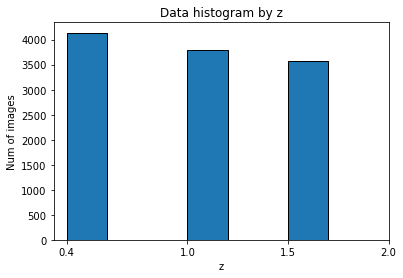

In [191]:
# You can plot here a histogram of the data-sets, to show the degree of 
# balancing of the parameter in "balanceParam":

if balanceParam != None:
    print('Histogram for the "balanceParam" and the class/phase:')
    plotBalancingHistogram(training_info_set)

/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:931: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:932: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


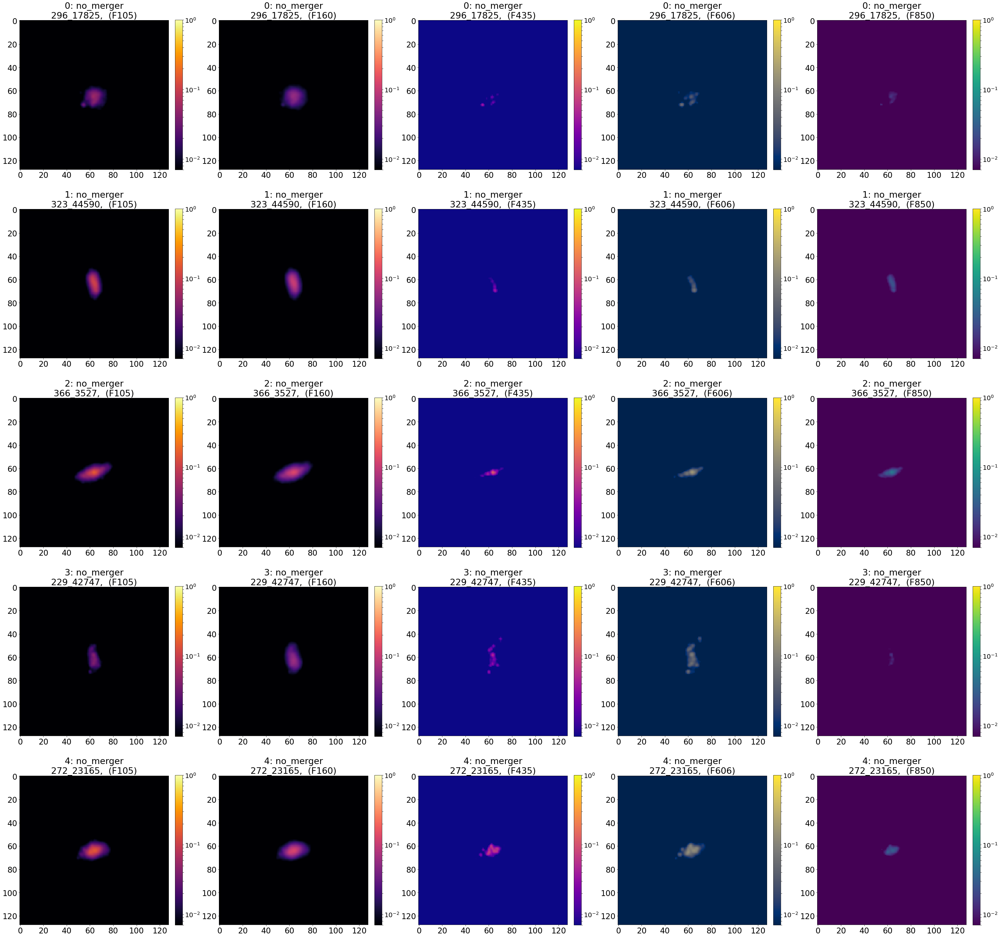

In [8]:
# Plot a sample of the images, with relevant extra data:

start, end = 0, 5
x_img_set, x_label_set, x_info_set = training_img_set, training_label_set, training_info_set
# x_img_set, x_label_set, x_info_set = validation_img_set, validation_label_set, validation_info_set
# x_img_set, x_label_set, x_info_set = test_img_set, test_label_set, test_info_set

extraInfoToPrint = [(str(extraInfo['ID'] + ', ') if 'ID' in extraInfo else '') + ('time: ' + str(extraInfo['time']) if \
                            'time' in extraInfo else '') for extraInfo in x_info_set[start:end]]
plot_img_in_blocks(x_img_set[start:end], x_label_set[start:end], extraInfoToPrint, startIdxForTitle=start)

In [192]:
# Returns an ImageDataGenerator object that generates random augmentations 
# on given images. There might be additional "manual" augmentations in 
# other functions.
# If you use augmentations that need general information over the entire set, 
# such as "featurewise_std_normalization", then you shoul give an image 
# data-set as an argument to "train_X". Then uncomment/add the desired 
# augmentations at will and run data_generator.fit(...).
def create_datagen(train_X=None):
    data_generator = ImageDataGenerator(
        rotation_range = 90,  # Assuming +-
        width_shift_range = 0.1,
        height_shift_range = 0.1,
        horizontal_flip = True,
        vertical_flip = True,
        fill_mode = 'constant', cval = 0)
    # Some augmentations, such as "featurewise_center", "featurewise_std_normalization" 
    # or "zca_whitening" require a train_X and running data_generator.fit(). If you use 
    # them, uncomment the next "if" statement:
#     if train_X is not None:
#         data_generator.fit(train_X, augment=True)

    return data_generator


# Plots a few augmented images out of a given data-set, in order to test the 
# augmentation data-generator.
def plot_augmented_data(datagen, dataSet, labelSet):
    totalNumOfImgs = 30
    cols = 5  # = Number of batches
    rows = int(np.ceil(totalNumOfImgs / cols))  # = Batch size
    fig = plt.figure(figsize=(14,14))
    
    # Show images from 'cols'(=5) batches and 1 filter band. Size of batch is 'rows':
    for batchIdx in range(cols):
        x_batch, y_batch = datagen.flow(dataSet, labelSet, batch_size = rows)[batchIdx]
        for i in range(len(x_batch)):
            plt.subplot(rows, cols, i * cols + batchIdx + 1)
            plt.title("batch: " + str(batchIdx) + ", img: " + str(i))
            plt.imshow(x_batch[i][:,:,0] + 1e-6, norm=SymLogNorm(linthresh=1e-6), vmin = vMin, vmax = vMax)
            plt.colorbar()
            plt.tight_layout()


# Manual image augmentations: Adds a random black box over the image.
def box_out(imgColors):
    boxLen = int(0.1 * imgColors.shape[0])
    for i in range(3):
        startY, startX = np.random.randint(0, imgColors.shape[0] - boxLen), np.random.randint(0, imgColors.shape[1] - boxLen)
        endY, endX = startY + boxLen, startX + boxLen

        imgColors[startY:endY, startX:endX, :] = 0


# Manual image augmentations: Change the brightness of the entire image by a random factor.
def change_brightness(imgColors):
    brightnessFactor = np.random.uniform(0.5, 1.5)
    imgColors *= brightnessFactor


# Gets an image data-set and adds additional manual augmentations (such as boxing out).
def add_more_augmentations(img_set):
    for imgColors in img_set:
#         change_brightness(imgColors)
#         box_out(imgColors)  # Random black box.
        continue


# Checking that the image data generation works properly, by plotting a sample of the 
# training set with augmentations:
tryDatagen = create_datagen(training_img_set)
plot_augmented_data(tryDatagen, dataSet=training_img_set, labelSet=training_label_set)

In [193]:
##### Define a module architecture  #######
# try Marc's architecture from 2018 blue-nuggets?

# Builds a fixed model architecture.
def build_default_model(inShape):
    # learning_rate = Optimizer learning rate (from 1e-2, 1e-3, or 1e-4):
    learning_rate = 2e-4 # 1e-4, 1e-3, 1e-2, 1e-1  # Default is 1e-3
    # Instantiate an optimizer:
    optimizer = k_optimizers.Adam(learning_rate = learning_rate)
    
    # CNN-7:

    model = Sequential()

    model.add(Conv2D(16, kernel_size=(3, 3), activation='relu',padding='same',input_shape=inShape))
    model.add(Conv2D(16, kernel_size=(3, 3), activation='relu',padding='same'))
    model.add(MaxPooling2D(pool_size=(2, 2),strides=2))

    model.add(Conv2D(32, kernel_size=(5, 5), activation='relu'))
    model.add(Conv2D(32, kernel_size=(5, 5), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2),strides=2))

    # model.add(Dropout(0.2))

    model.add(Conv2D(64, kernel_size=(5, 5), activation='relu'))
    model.add(Conv2D(64, kernel_size=(5, 5), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2),strides=2))

    # model.add(Dropout(0.2))

    model.add(Dropout(0.2))

    model.add(Flatten())
    model.add(Dense(512, activation='relu'))
    model.add(Dense(len(class_keys_reversed), activation='softmax')) # try with 1 class and sigmoid(0-1)
    
#     print(model.summary())

    # Compiles the model. Adds the loss function and the optimizer:
    model.compile(loss='categorical_crossentropy', optimizer = optimizer, metrics=['accuracy'])

    return model


# Builds a tunable model with hyperparameters.
def build_tuned_model(loss_fn, inShape):
    # The nested function will be returned. This way it'll have an access to "loss_fn" and 
    # "inShape" locally, without the need to pass them as arguments (kt.Hyperband() is the 
    # caller and it won't do it). The alternative will be to have them as global parameters.
    def build_tuned_model_with_parameters(hyperT):
        pass
    return build_tuned_model_with_parameters


# prints the optimal hyperparameters:
def print_best_parameters(best_hps):
    print(f"""
    The hyperparameter search is complete. The optimal number of units in the first densely-connected
    layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
    is {best_hps.get('learning_rate')}.
    """)
    print(f"""
    The optimal batch size is: {best_hps.get('batch_size')}
    The optimal number of epoch is: {best_hps.get('epochs')}
    """)
    print('-----------------------------\n')
    print("The best hyperparameters for the model are:\n" + str(tuner.get_best_hyperparameters(1)[0]))
    print('-----------------------------\n')
    print('Tuner results summery:\n' + str(tuner.results_summary()))
    print('-----------------------------\n')


# Returns a tuned model with optimal hyperparameters, for the given data-sets.
# Also prints the results.
def tune_hyperparameters(loss_fn, inShape, training_set, validation_set):
    pass


# Get a model: Load a pretrained one, if allowed and exists, or build a new one:

# Instantiate a loss function:
loss_fn = k_losses.CategoricalCrossentropy(from_logits = False)
# Gets the input shape for an image:
inShape = get_input_shape_from_Kbackend(training_img_set[0]) # No need for the address/image argument!

# The model's path:
if addBackgroundOnlyDuringLearning and backgroundPathAddition != '':
    modelBGPathAddition = 'trained_model' + backgroundPathAddition
else:
    modelBGPathAddition = ''
modelPath = os.path.join(get_data_structure_specific_case_dir(), modelBGPathAddition, 'trained_model')

# modelPath example:
# '/vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/case13merger(pre(-03-0)-post(0-03))_VS_no-mergers(w05-)_filters-F105F160F435F606F850_padded_and_cropped_128_centered_0_bg_z--Balanced_psf_3/trained_model_CANDELSbg/trained_model'

# Load a presaved model:
if loadPreTrainedModel and os.path.exists(modelPath):
    print('Loading a model from: \"' + modelPath + '\"')
    model = load_model(modelPath)
# Create a new model:
else:
    print('Building a new model.')
    if useHyperparametersTuner:  # Create a tunable model.
        model = tune_hyperparameters(loss_fn, inShape, (training_img_set, training_label_set), (validation_img_set, validation_label_set))
    else:  # Create a fixed model.
        model = build_default_model()

Loading a model from: "/vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/case13merger(pre(-03-0)-post(0-03))_VS_no-mergers(w045-)_filters-F105F160F435F606F850_padded_and_cropped_128_centered_0_bg_z--Balanced_dynT_psf_z(0-2)/trained_model_CANDELSbg/trained_model"


In [194]:
# Prints a summary of the model and its architecture:

print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 128, 128, 16)      736       
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 16)      2320      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 64, 64, 16)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 60, 60, 32)        12832     
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 56, 56, 32)        25632     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 28, 28, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 24, 24, 64)       

In [195]:
# Wrapper and overwiter functions for model.fit:

# Adds a random background to each image.
def add_backgrounds_to_data_set(dataSet):
    for images in dataSet:
        # Temporary reshape the image from (128, 128, #bands) to (#bands, 128, 128), and adds the backgrounds:
        # Note: It doesn't copy the data. It's just by reference! Numpy.transpose didn't work here?
        imgByBand = [images[:, :, bandIndex] for bandIndex in range(images.shape[2])]
        add_background(imgByBand, bandFilterList)


# An overwrite of Keras' model.fit() function. The idea is to better control 
# augmentations and backgrounds adding at each step.
# It returns a modelHistory object that behaves like in Keras.model.fit.
def run_my_fit(training_set, validation_set):
    # Will hold record of key metric values across the training:
    class Model_history:
        def __init__(self, dictKeysLst):
            self.history = {}
            for key in dictKeysLst:
                self.history[key] = []
            
    modelHistory = Model_history(('accuracy', 'loss', 'val_accuracy', 'val_loss'))
    train_img_set, train_label_set = training_set
    validation_img_set, validation_label_set = validation_set
    # Slice into batches:
    val_dataset_tf_batches = [(validation_img_set[i:i + batch_size], validation_label_set[i:i + batch_size]) \
                              for i in range(0, len(validation_img_set), batch_size)]
#     val_dataset_tf_batches = tf.data.Dataset.from_tensor_slices((validation_img_set, validation_label_set)).batch(batch_size)
    
    # Preparing the progress bar:
    progress_bar_len = 30
    steps_per_epoch = np.ceil(train_img_set.shape[0] / batch_size).astype(int)  # Number of batches per epoch.
    steps_per_bar = steps_per_epoch / progress_bar_len
    progress_bar_template = '[{0:.<%d}]' % (progress_bar_len)
    
    # Starts the training loop:
    total_start_time = time_module.time()
    epoch_end_time = 0
    for epoch in range(epochs):
        print("Epoch %d/%d" % (epoch+1, epochs))
        epoch_start_time = time_module.time()
        
        # Preparing to fit:
        trainDatagen = create_datagen(train_img_set)  # Creates new data generated samples:
        model.reset_metrics()  # Reset metric for next running.
        train_loss_lst, train_acc_lst = [], []  # To log the training results.
        
        # Iterate over the batches of the dataset and fit on each one:
        for step, (train_batch_img, train_batch_label) in enumerate(trainDatagen.flow( \
                                train_img_set, train_label_set, batch_size=batch_size)):
            if step == steps_per_epoch:
                break
            
            #  Adds backgrounds to the images if needed.
            # It's important to do it here and not outside the loop (as in major_merger_classifier), 
            # because here we don't sample a random set every epoch and just use the original one.
            if addBackgroundOnlyDuringLearning:
                add_backgrounds_to_data_set(train_batch_img)
            # Add additional manual augmentations:
            add_more_augmentations(train_batch_img)
            
            # Train on batch:
            train_batch_loss, train_batch_acc = model.train_on_batch(train_batch_img, \
                                        train_batch_label, reset_metrics=False)  # Run a single training on this batch.
            train_loss_lst.append(train_batch_loss)
            train_acc_lst.append(train_batch_acc)
            
            # Print progress bar:
            epoch_ETA = epoch_end_time + epoch_start_time - time_module.time()
            time_str = 'ETA: %ds' % int(epoch_ETA) if epoch_end_time > 0 else '%ds' % int(-epoch_ETA)
            print(('%d/%d ' + progress_bar_template.format('=' * int(step / steps_per_bar) + '>') + \
                  ' - %s - loss: %.4f - accuracy: %.4f') % (step+1, steps_per_epoch, time_str, float(train_batch_loss), \
                                                           float(train_batch_acc)), end="\r", flush=True)
        
        # By the end of the epoch, get the loss and metric results:
        train_loss, train_acc = np.mean(train_loss_lst), np.mean(train_acc_lst)
        
        # Run a validation loop at the end of each epoch and calculate the mean validation loss and accuracy.
        val_loss_lst, val_acc_lst = [], []
        for val_batch_img, val_batch_label in val_dataset_tf_batches:
            #  Adds backgrounds to the images if needed:
            if addBackgroundOnlyDuringLearning:
                val_batch_img = val_batch_img.copy()
                add_backgrounds_to_data_set(val_batch_img)
            # Test the batch and get the results:
            val_batch_loss, val_batch_acc = model.test_on_batch(val_batch_img, val_batch_label, reset_metrics=True) #test the model on the validation set
            val_loss_lst.append(val_batch_loss)
            val_acc_lst.append(val_batch_acc)
        # Get the toal mean value of all the batches:
        val_loss, val_acc = np.mean(val_loss_lst), np.mean(val_acc_lst)
        
        # Record the metrics and the losses at the end of each epoch:
        modelHistory.history['accuracy'].append(train_acc)
        modelHistory.history['loss'].append(train_loss)
        modelHistory.history['val_accuracy'].append(val_acc)
        modelHistory.history['val_loss'].append(val_loss)
        
        # print progress bar complete:
        epoch_end_time = time_module.time() - epoch_start_time
        epoch_end_time_ms = (epoch_end_time - int(epoch_end_time)) * 1000
        print('%d/%d [%s] - %ds %dms/step - loss: %.4f - accuracy: %.4f - val_loss: %.4f - val_accuracy: %.4f' % \
              (steps_per_epoch, steps_per_epoch, '=' * progress_bar_len, int(epoch_end_time), int(epoch_end_time_ms), \
               float(train_loss), float(train_acc), float(val_loss), float(val_acc)), end="\r", flush=True)
        print()
    
    print("\nTime taken: %.2fs" % (time_module.time() - total_start_time))
    
    return modelHistory


# A wrapper of Keras' model.fit() function. If "addBackgroundOnlyDuringLearning"
# is True, the function adds backgrounds to the images of the data-sets before
# Calling model.fit().
# Returns a modelSeq history object of the fitting.
def run_default_fit(training_set, validation_set):
    training_datas, training_labels = training_set[0], training_set[1]
    validation_datas, validation_labels = validation_set[0], validation_set[1]
    
    #  Adds backgrounds to the images if needed:
    if addBackgroundOnlyDuringLearning:
        training_datas = training_datas.copy()
        validation_datas = validation_datas.copy()
        add_backgrounds_to_data_set(training_datas)
        add_backgrounds_to_data_set(validation_datas)
        print('Backgrounds were added.\n')
    
    # Creates new data generated samples:
    trainDatagen = create_datagen(training_datas)
    
    # Run the fit:
    start_time = time_module.time()
    modelSeq = model.fit(trainDatagen.flow(training_datas, training_labels, batch_size = batch_size), \
                         steps_per_epoch=np.ceil(len(training_datas) / batch_size), epochs=epochs, verbose=1, \
                         validation_data=(validation_datas, validation_labels), shuffle=True)
    print("\nTime taken: %.2fs" % (time_module.time() - start_time))
    return modelSeq

In [196]:
# Load backgrounds tensor to later add them to the images:
if chooseBackground != 0 and addBackgroundOnlyDuringLearning:
    backgroundTensor = load_background_tensor()

if skipTraining:
    print('Skipping training.')
#     # Uncomment and modify if you skip training and want all the samples to be in the test set:
#     # Comment-out if you want to do the training, or skip it and test regularly with the loaded model on the test-set only.
#     test_img_set = np.concatenate([training_img_set, test_img_set])
#     test_info_set = np.concatenate([training_info_set, test_info_set])
#     test_label_set = np.concatenate([training_label_set, test_label_set])
else:
    # Trains the model, either by the default keras' model.fit(), or by my own training loop:
    if runMyFit:
        modelSeq = run_my_fit((training_img_set, training_label_set), (validation_img_set, validation_label_set))
    else:
        modelSeq = run_default_fit((training_img_set, training_label_set), (validation_img_set, validation_label_set))

Skipping training.


/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:34: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [197]:
# Functions for plotting and evaluation of the results:

# Evaluate the model N times (1 or 100) over the testing set, with/out different 
# backgrounds at each time, then calculate and return the mean value and error 
# range of the predictions, the loss and accuracy.
# averagedEvaluation - If True run N (100) evaluations. If False then only 1.
def evaluate_and_predict_model(model, test_img_set_original, test_label_set, averagedEvaluation):
    # Load backgrounds tensor and adds it to the test image set (if didn't already):
    if chooseBackground != 0 and addBackgroundOnlyDuringLearning:
        addBG = True
    else:
        addBG = False
    
    sigmas = 1  # The error range. For a normal distribution 1S = 68%, 2S = 95%, ...
    
    # We run 100 runs in training mode (to allow dropout) with new BGs in each, and return 
    # the averaged predictions, loss and accuracy, as well as their error range:
    if averagedEvaluation == True:
        N = 20
        print('Evaluate and predict in ' + str(N) + ' steps with ' + str(sigmas) + ' sigmas uncertainty, while resampling BGs.\n')
        predictionLst, predLossLst, predAccLst = [], [], []
        
        # Runs N times and for each one calculate the predictions, loss and accuracy for all the images:
        for _ in range(N):
            # Adds different backgrounds to the images at each iteration:
            if addBG:
                test_img_set = np.copy(test_img_set_original)
                add_backgrounds_to_data_set(test_img_set)
            else:  # No backgrounds should be added.
                test_img_set = test_img_set_original
            predictions = model.predict(test_img_set)  # (num of classes)*predictions matrix, with the percentages for each class for each prediction.
            predictionLst.append(predictions)
            predLossLst.append(loss_fn(test_label_set, predictions).numpy())
            predAccLst.append(np.mean(np.round(predictions) == test_label_set))
        
        # Converts into numpy arrays:
        predictionLst = np.stack(predictionLst)
        predLossLst = np.stack(predLossLst)
        predAccLst = np.stack(predAccLst)
        
        # Calculates the mean values for each image, over the N runs:
        predictionsFinal = predictionLst.mean(axis=0)
        lossFinal = predLossLst.mean(axis=0)
        accFinal = predAccLst.mean(axis=0)
        # Calculates the error ranges for each image, over the N runs:
        predErr = (sigmas * np.sqrt(accFinal * (1 - accFinal) / test_label_set.shape[0])) * np.ones(predictionsFinal.shape)
        accErr = sigmas * np.sqrt(accFinal * (1 - accFinal) / test_label_set.shape[0])
        lossErr = sigmas * predLossLst.std(axis=0) / np.sqrt(N)
        
    # We make only 1 run and return it:
    else:
        print('Evaluate and predict in one step.\n')
        
        # Adds backgrounds to the images:
        if addBG:
            test_img_set = np.copy(test_img_set_original)
            add_backgrounds_to_data_set(test_img_set)  #  Adds backgrounds to the images.
        else:  # No backgrounds should be added.
            test_img_set = test_img_set_original
        
        # Gets the values for each image, over 1 run:
        predictionsFinal = model.predict(test_img_set)
        lossFinal, accFinal = model.evaluate(test_img_set, test_label_set, verbose=0)
        # Gets the error ranges for each image, over 1 run:
        predErr, lossErr, accErr = np.zeros(predictionsFinal.shape), 0, 0
    
    return predictionsFinal, lossFinal, accFinal, predErr, lossErr, accErr


# Returns the decisive predictions w/o the error-range. Each cell in "predictionSet" is 
# checked and the class with the highest certainty is taken as the final prediction.
# In addition, we return 2 decisive-prediction sets representing "extreme-scenarios", 
# by taking into account the error-range of each prediction.
def get_decisive_predictions(predictionSet, predErrSet):
    decisivePred_final = np.argmax(predictionSet, axis=1)
    decisivePred_min = np.empty(predictionSet.shape, dtype=int)
    decisivePred_max = np.empty(predictionSet.shape, dtype=int)
    
    # The min/max results of every class:
    if predErrSet is None:
        decisivePred_min, decisivePred_max = None, None
    else:
        for clsIdx in range(predictionSet.shape[1]):
            # The minimal decisive predictions for each class:
            minPrediction = predictionSet + predErrSet
            minPrediction[:,clsIdx] -= (2 * predErrSet[:,clsIdx])
            decisivePred_min[:,clsIdx] = np.argmax(minPrediction, axis=1)

            # The maximal decisive predictions for each class:
            maxPrediction = predictionSet - predErrSet
            maxPrediction[:,clsIdx] += (2 * predErrSet[:,clsIdx])
            decisivePred_max[:,clsIdx] = np.argmax(maxPrediction, axis=1)
    
    return decisivePred_final, decisivePred_min, decisivePred_max


# Plots histogram graphs and print values of the results probability distribution.
# The histograms show, for each class, the number of its images in each probability 
# value bin to be in that class, as were predicted by the model.
def plot_probability_histogram_by_class(totalCorrelation, classCorrelations):
    # Prints the confidence for each class seperately:
    print('====== Confidence results: ======')
    for clsIdx in classCorrelations:
        print('Average probability of \'' + class_keys_reversed[clsIdx] + '\' class = ' + \
              str(round(np.mean(classCorrelations[clsIdx]), 3)) + ', STD = ' + \
              str(round(np.std(classCorrelations[clsIdx]), 3)))
        plt.title('\'' + class_keys_reversed[clsIdx] + '\' class confidence histogram (test set)')
        plt.xlabel('probabilities')
        plt.ylabel('Num of images')
        plt.hist(classCorrelations[clsIdx], bins = np.linspace(0, 1, int(max(15, np.ceil(len(classCorrelations[clsIdx])/10)))), \
                 alpha = 0.6, ec='black')
        plt.xticks(np.arange(0, 1, 0.1))
        plt.grid()
        plt.show()
    
    # For a binary case, prints a combined graph:
    if len(classCorrelations) == 2:
        plt.title('Combined class confidence histogram (test set)')
        plt.xlabel('probabilities')
        plt.ylabel('Num of images')
        clsIdx = 0
        plt.hist(classCorrelations[clsIdx], bins = np.linspace(0, 1, int(max(15, np.ceil(len(classCorrelations[clsIdx])/10)))), \
                 alpha = 0.6, ec='black', label = '\'' + str(class_keys_reversed[clsIdx]) + ' \' phase')
        clsIdx = 1
        plt.hist(1 - classCorrelations[clsIdx], bins = np.linspace(0, 1, int(max(15, np.ceil(len(classCorrelations[clsIdx])/10)))), \
                 alpha = 0.6, ec='black', label = '\'' + str(class_keys_reversed[clsIdx]) + ' \' phase')
        plt.xticks(np.arange(0, 1, 0.1))
        plt.legend()
        plt.grid()
        plt.show()
    
    print('\nTotal correlation (averaged) = ' + str(round(np.mean(totalCorrelation), 3)) + ', STD = ' + \
          str(round(np.std(totalCorrelation), 3)))
    print()


# Calculates and prints the Precision and Recall values of the prediction results, 
# with the error ranges.
def print_precision_recall(y_true, y_pred_decisive, y_predDec_min, y_predDec_max):
    # Mean precision and mean recall:
    precisionMean = precision_score(y_true, y_pred_decisive)
    recallMean = recall_score(y_true, y_pred_decisive)
    
    # precision and recall error. Assuming there are only 2 classes:
    precisionErr = max(abs(precisionMean - precision_score(y_true, y_predDec_min)),
                       abs(precisionMean - precision_score(y_true, y_predDec_max)))
    recallErr = max(abs(recallMean - recall_score(y_true, y_predDec_min)), \
                    abs(recallMean - recall_score(y_true, y_predDec_max)))
    
    print('Precision = ' + str(np.round(precisionMean, 3)) + ' +/- ' + str(np.round(precisionErr, 3)))
    print('Recall = ' + str(np.round(recallMean, 3)) + ' +/- ' + str(np.round(recallErr, 3)))
    print()


# Plots ROC precision and recall curves.
def plot_ROC_precision_recall_curves(y_true, y_pred):
    print('====== ROC curves: ======')
    
    #y_true - true labels; y_pred - machine output
    fpr, tpr, thresh = roc_curve(y_true, y_pred)
    #fpr - false positive rate; tpr - true positive rate; thresh - a list of thresholds;
    #the following code will plot the curve, and the curve will be colored w.r.t the threshold
    points = np.array([fpr, tpr]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    fig, axs = plt.subplots(1, 1)
    norm = plt.Normalize(vmin=0, vmax=1)
    lc = LineCollection(segments, cmap='jet', norm=norm)
    lc.set_array(thresh)
    lc.set_linewidth(3)
    line = axs.add_collection(lc)
    fig.colorbar(line, ax=axs)
    axs.plot(np.linspace(0, 1, 100), np.linspace(0, 1, 100), linestyle='dashed', color='black', linewidth=1)
    axs.set_xlabel('FPR',fontsize=15)
    axs.set_ylabel('TPR/Recall',fontsize=15)

    precision, recall, thresh = precision_recall_curve(y_true, y_pred)
    points = np.array([precision, recall]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    fig, axs = plt.subplots(1, 1)
    norm = plt.Normalize(vmin=0,vmax=1)
    lc = LineCollection(segments,cmap='jet', norm=norm)
    lc.set_array(thresh)
    lc.set_linewidth(3)
    line = axs.add_collection(lc)
    fig.colorbar(line, ax=axs)
    axs.set_xlabel('Precision', fontsize=15)
    axs.set_ylabel('TPR/Recall', fontsize=15)


# Gets a confusion matrix of the results and plots it as a colored graph. 
# Meaning the real VS classified labels, with error ranges.
def plot_confusion_matrix(cmat, cmatErrMin, cmatErrMax):
    fontSize = 20
    matfig = plt.figure(figsize=(8, 8))
    plt.matshow(cmat, cmap=plt.cm.Blues, fignum=matfig.number)
    for (y, x), value in np.ndenumerate(cmat):
        plt.text(x, y, f"{value:.3f}" + " $_{-" + f"{cmatErrMin[y, x]:.3}" + "}^{+" + f"{cmatErrMax[y, x]:.3}" + "}$", va='center', ha='center', color=('white' if value > 0.5 else 'black'), fontsize=fontSize)
    labels = list(class_keys_reversed.values())
    tick_marks = np.arange(cmat.shape[0])
    plt.xticks(ticks=tick_marks, labels=labels, rotation=45, fontsize=fontSize)
    plt.yticks(ticks=tick_marks, labels=labels, fontsize=fontSize)
    plt.ylabel('True label', fontsize=fontSize)
    plt.xlabel('Predicted label', fontsize=fontSize)
    plt.gca().xaxis.tick_bottom()
    cbar = plt.colorbar(fraction=0.046, pad=0.04)
    cbar.ax.tick_params(labelsize=fontSize)


# Gets a confusion matrix of the results and prints it as a table, with 
# error ranges (similar to the confusion matrix).
def print_result_matrix_with_err(res_mat, resErrMin_norm, resErrMax_norm):
    predictCounts = res_mat.sum(axis=0)
    realCounts = res_mat.sum(axis=1)

    # Preparing the plot format:
    template = "{0:11}{1:^3}"#{2:^10}{3:^10}{4:^10}{5:^10}"
    for i in range(res_mat.shape[1]):
        template += "{" + str(i + 2) + ":^12}"
    predictionsFormatTxt = ['predictions_mean', ':']
    
    # Prints the mean-results:
    print('====== Final results matrix: ======')
    print('Real\n' + '-'*12)
    for clsIdx in class_keys_reversed:
        normalizedResults = res_mat[clsIdx] / (realCounts[clsIdx] if realCounts[clsIdx] != 0 else 1)
        print(template.format(class_keys_reversed[clsIdx] + ' (' + str(realCounts[clsIdx]) + ')', ':', *np.around(normalizedResults, decimals=3)))
        predictionsFormatTxt.append(class_keys_reversed[clsIdx] + '(' + str(predictCounts[clsIdx]) + ')')
    print('-'*(14 + 12 * (len(predictionsFormatTxt) - 2))) # 54
    print(template.format(*predictionsFormatTxt))
    print()
    
    # Prints the min/max results' error range:
    print('Err - :\n' + str(resErrMin_norm))
    print('Err + :\n' + str(resErrMax_norm))
    print()


# Gets the real and predicted decisive results, with the error ranges, 
# and calculates and returns a confusion matrix.
def calculate_confusion_matrix(y_true, y_pred, normalize):
    cmat = confusion_matrix(y_true, y_pred, normalize=normalize)
    cmatExtremeSet = np.vstack(([confusion_matrix(y_true, y_pred_min[:, clsBiasedIdx], normalize=normalize) for clsBiasedIdx in range(y_pred_min.shape[1])], \
                                [confusion_matrix(y_true, y_pred_max[:, clsBiasedIdx], normalize=normalize) for clsBiasedIdx in range(y_pred_max.shape[1])]))
    cmatErrMin = (cmat - np.min(cmatExtremeSet, axis=0))
    cmatErrMax = (np.max(cmatExtremeSet, axis=0) - cmat)
    
    return (cmat, cmatErrMin, cmatErrMax)


# Gets the real and predicted decisive results, with the error ranges, 
# calculates a confusion matrix and plots it both a a colored graph and a table.
def print_and_plot_confusion_matrix(y_true, y_pred, y_pred_min, y_pred_max):
    # Unormalized matrices:
    cmat, cmatErrMin, cmatErrMax = calculate_confusion_matrix(y_true, y_pred, None)
    # Normalized matrices by real labels:
    cmat_norm, cmatErrMin_norm, cmatErrMax_norm = calculate_confusion_matrix(y_true, y_pred, 'true')
    
    # Plot and print:
    plot_confusion_matrix(cmat_norm, cmatErrMin_norm, cmatErrMax_norm)
    print_result_matrix_with_err(cmat, cmatErrMin, cmatErrMax)


# Given a class name (from phase_keys), plot images that were classified as such by the model.
def plot_classImgs(img_set, decisivePredictions, classStr, iStart, iEnd, plotLabels=True, \
                   plotExtrInfo=True, plotDecPred=True, plotCorelations=True, label_set=None, \
                   info_set=None, totalCorrelation=None):
    classMask = []
    # Collect all the images that were classified as "classStr":
    for i, predLbl in enumerate(decisivePredictions):
        if phase_keys_reversed[predLbl] == classStr:  # Add this if you want only wrong classifications: and np.argmax(label_set[i]) != predLbl:
            classMask.append(i)
    classMask = classMask[iStart : iEnd]  # Only take images between "iStart" and "iEnd".
    
    # Extract the subset of images and other info to plot:
    imgClassSet = np.copy(img_set[classMask])
    infoClassSet = info_set[classMask] if plotExtrInfo else None
    labelClassSet = label_set[classMask] if plotLabels else None
    decisiveClassSet = decisivePredictions[classMask] if plotDecPred else None
    totClassCorSet = [totalCorrelation[i] for i in classMask] if plotCorelations else None
    if infoClassSet is not None:
        classTestExtraInfoToPrint = [(str(extraInfo['ID'] + ', ') if 'ID' in extraInfo else '') + \
                                     ('z: ' + str(np.round(extraInfo['z'], 2)) + ', ') + \
                                     ('M: ' + str(np.round(extraInfo['mass'], 2)) + ' e10' + '\n') +\
                                     ('time: ' + str(extraInfo['time']) if 'time' in extraInfo else '') \
                                     for extraInfo in infoClassSet]
    else:
        classTestExtraInfoToPrint = None
    
    # Add backgrounds and plot:
    add_backgrounds_to_data_set(imgClassSet)
    plot_img_in_blocks(imgClassSet, labelClassSet, classTestExtraInfoToPrint, decisiveClassSet, totClassCorSet)

Evaluate and predict in one step.

	['loss', 'accuracy']
score = [0.29  0.902] +/- [0 0]
Mean predErr = 0.0
====== Confidence results: ======
Average probability of 'merger' class = 0.89, STD = 0.24


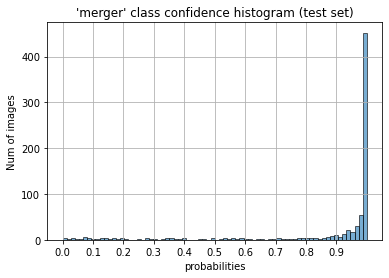

Average probability of 'no_merger' class = 0.83, STD = 0.238


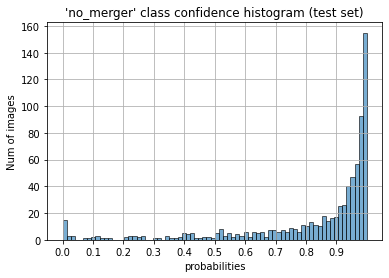

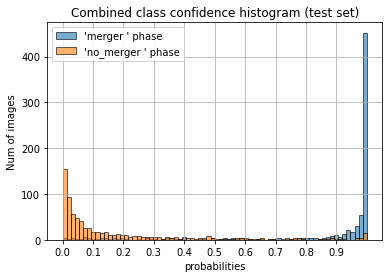


Total correlation (averaged) = 0.86, STD = 0.241

Precision = 0.903 +/- 0.0
Recall = 0.901 +/- 0.0

====== ROC curves: ======
====== Final results matrix: ======
Real
------------
merger (750) :    0.903       0.097    
no_merger (750) :    0.099       0.901    
--------------------------------------
predictions_mean : merger(751) no_merger(749)

Err - :
[[0. 0.]
 [0. 0.]]
Err + :
[[0. 0.]
 [0. 0.]]



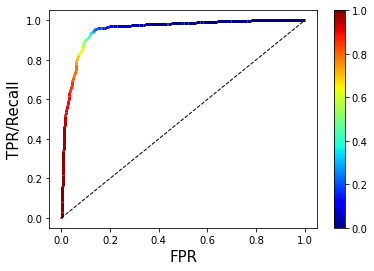

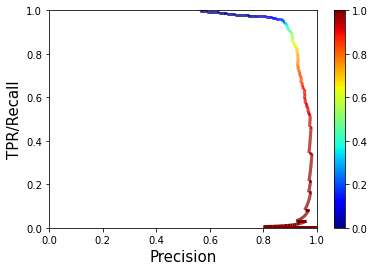

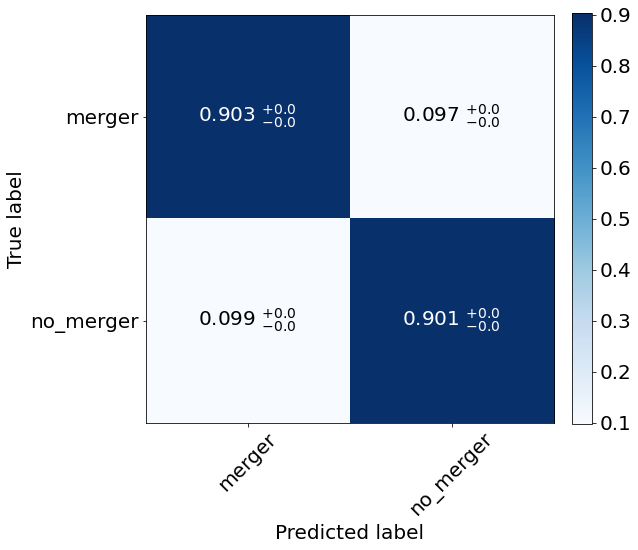

In [198]:
# Evaluate the model's performance using the testing-set:

prediction, lossVal, accVal, predErr, lossErr, accErr = evaluate_and_predict_model(model, test_img_set, test_label_set, averagedEvaluation)
print('\t' + str(model.metrics_names))
print("score = " + str(np.round((lossVal, accVal), 3)) + ' +/- ' + str(np.round([lossErr, accErr], 4)))
print('Mean predErr = ' + str(np.round(np.mean(predErr), 3)))

# Results format, with/without "None" class for low certainty classifications:
useNoneClass = True  # Whether or not show "None" class for classification of low certainty.
noneClassThreshold = 1 / len(class_keys_reversed)  # The certainty limint for the "None" class (unclassified).

# For evaluating:
decisivePredictions, decisivePred_min, decisivePred_max = get_decisive_predictions(prediction, predErr)  # A set of the final predictions.
totalCorrelation = [np.dot(test_label_set[i], prediction[i]) for i in range(len(prediction))] # For all the results.

# Extracts the correlations per class: Sort the images by their true-labels, 
# and keep their predicted probability for their true-label:
classCorrelations = {clsIdx : [] for clsIdx in class_keys_reversed}  # For each class separately.
for i in range(len(prediction)):
    clsIdx = np.where(test_label_set[i] == 1)[0][0]
    classCorrelations[clsIdx].append(np.dot(test_label_set[i], prediction[i]))
for clsIdx in classCorrelations:
    classCorrelations[clsIdx] = np.array(classCorrelations[clsIdx])

# Plots the results:

plot_probability_histogram_by_class(totalCorrelation, classCorrelations)
if len(class_keys_reversed) == 2:
    print_precision_recall(test_label_set[:,1], decisivePredictions, decisivePred_min[:,1], decisivePred_max[:,1])
    plot_ROC_precision_recall_curves(test_label_set[:,1], prediction[:,1])  # [:,1]=values of the 2nd class (~class' index)

print_and_plot_confusion_matrix(np.argmax(test_label_set, axis=1), decisivePredictions, decisivePred_min, decisivePred_max)

if not skipTraining:
    # Plots a graph of the training loss and the validation loss:
    plt.figure()
    plt.plot(range(epochs), modelSeq.history['loss'], color='blue', label='Training loss')
    plt.plot(range(epochs), modelSeq.history['val_loss'], color='red', label='Validation loss')
    plt.title('Training and validation loss VS epochs. test loss = ' + str(round(lossVal, 3)))
    plt.xlabel('Number of epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    # Plots a graph of the training accuracy and the validation accuracy:
    plt.figure()
    plt.plot(range(epochs), modelSeq.history['accuracy'], color='blue', label='Training accuracy')
    plt.plot(range(epochs), modelSeq.history['val_accuracy'], color='red', label='Validation accuracy')
    plt.title('Training and validation accuracy VS epochs. test acc = ' + str(round(accVal, 3)))
    plt.xlabel('Number of epochs')
    plt.ylabel('accuracy')
    plt.legend()
    plt.show()

     [merger no_merger]  Predictions    correlations  Final answer
--------------------------------------------------------------------------
0: Phase: [1. 0.] -- [0.007 0.993] -- 0.007  ---  no_merger
1: Phase: [1. 0.] -- [0.894 0.106] -- 0.894  ---  merger
2: Phase: [0. 1.] -- [0.039 0.961] -- 0.961  ---  no_merger
3: Phase: [1. 0.] -- [0.078 0.922] -- 0.078  ---  no_merger
4: Phase: [0. 1.] -- [0.286 0.714] -- 0.714  ---  no_merger
5: Phase: [1. 0.] -- [1. 0.] -- 1.0  ---  merger
6: Phase: [0. 1.] -- [0.003 0.997] -- 0.997  ---  no_merger
7: Phase: [1. 0.] -- [0.975 0.025] -- 0.975  ---  merger
8: Phase: [0. 1.] -- [0.288 0.712] -- 0.712  ---  no_merger
9: Phase: [0. 1.] -- [0.002 0.998] -- 0.998  ---  no_merger


/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:931: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:932: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


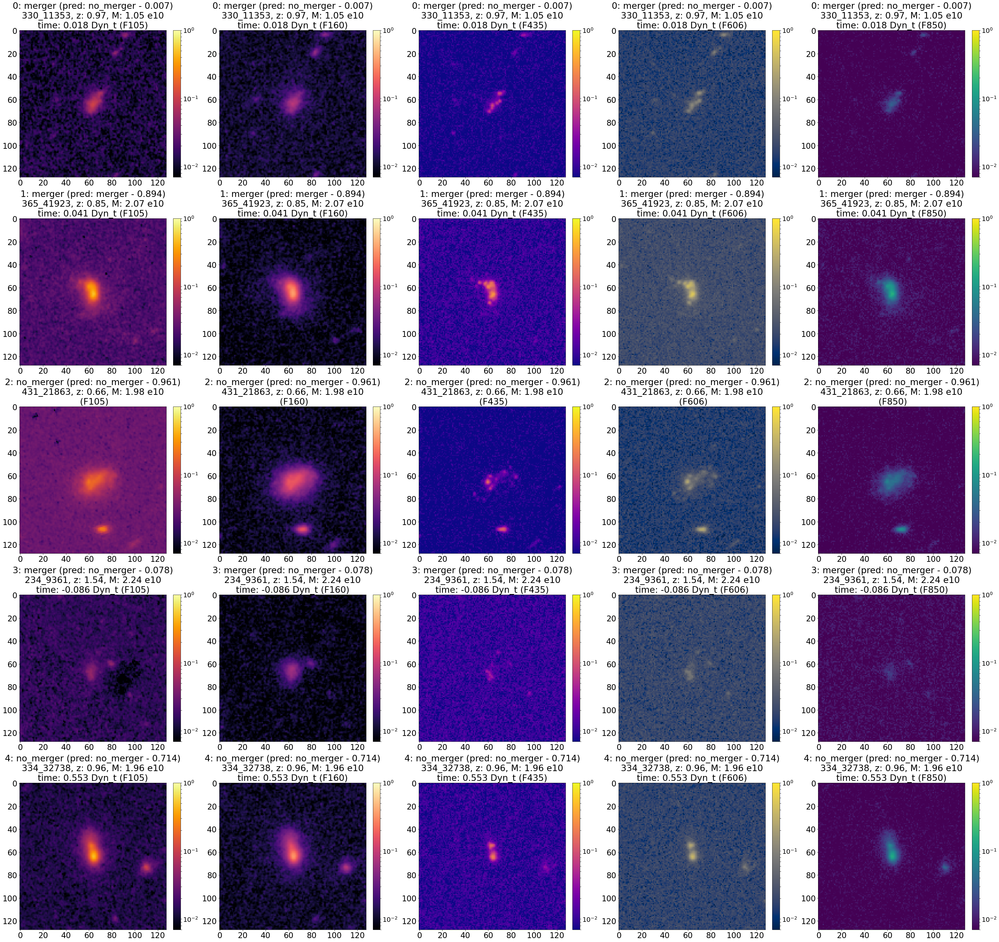

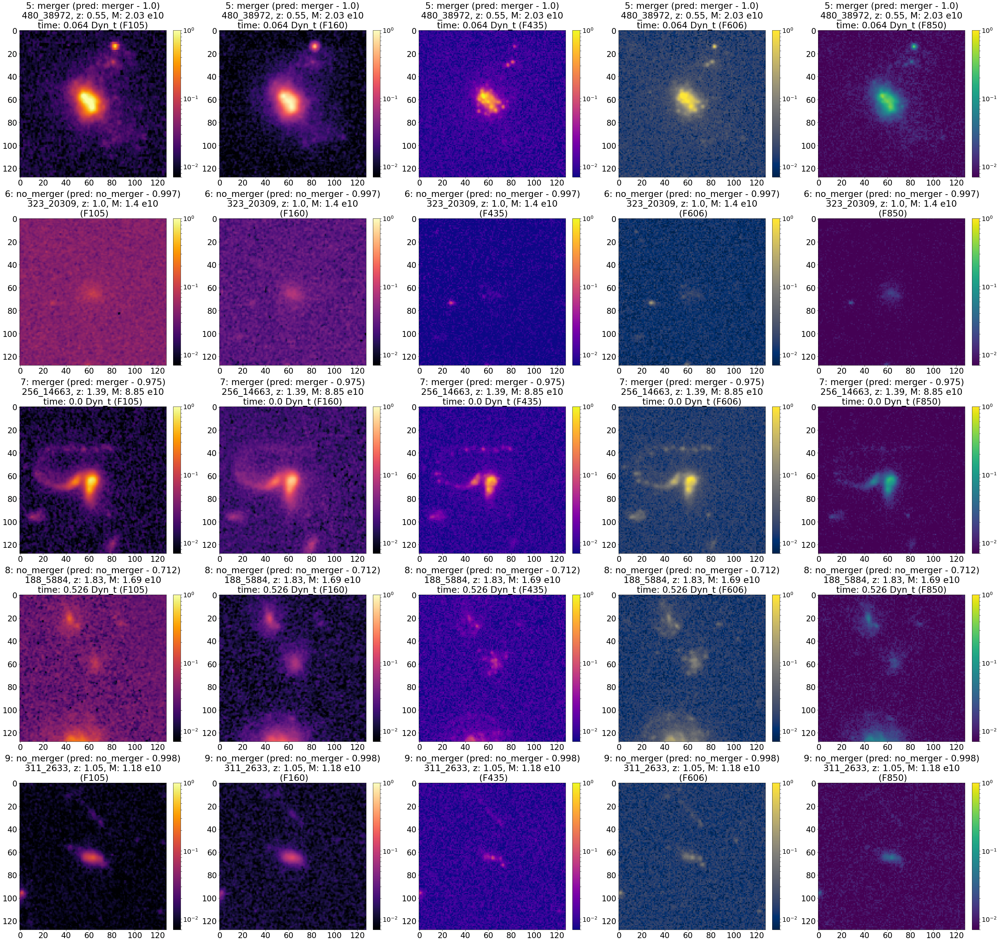

In [96]:
# Prints a data table for a sample of the evaluation results:
startPredictIdx, endPredictIdx = 0, 10  # The sample size
classTitles = '[' + ' '.join(cls for cls in class_keys_reversed.values()) + ']'
print(' '*(5 if len(classTitles) > 14 else 8) + classTitles + ' '*1 * len(class_keys_reversed) + 'Predictions' + ' '*4 + 'correlations' + ' '*2 + \
      'Final answer' + '\n' + '-'*74)
for i in range(startPredictIdx, endPredictIdx):
    print(str(i) + ': Phase: ' + str(test_label_set[i]) + ' -- ' + str(np.around(prediction[i], decimals=3)) + \
          ' -- ' + str(round(totalCorrelation[i], 3)) + '  ---  ' + (class_keys_reversed[decisivePredictions[i]] if \
                                                              decisivePredictions[i] in class_keys_reversed else 'None'))

# Plots the relevant images of the sample with their labels:
testExtraInfoToPrint = [(str(extraInfo['ID'] + ', ') if 'ID' in extraInfo else '') + \
                        ('z: ' + str(np.round(extraInfo['z'], 2)) + ', ') + \
                        ('M: ' + str(np.round(extraInfo['mass'], 2)) + ' e10' + '\n') + \
                        ('time: ' + str(extraInfo['time']) if \
                        'time' in extraInfo else '') for extraInfo in test_info_set[startPredictIdx:endPredictIdx]]
test_img_set_withBG = np.copy(test_img_set[startPredictIdx : endPredictIdx])
add_backgrounds_to_data_set(test_img_set_withBG)  # Skip or comment-out if you don't want backgrounds.
plot_img_in_blocks(test_img_set_withBG, test_label_set[startPredictIdx:endPredictIdx], \
                   testExtraInfoToPrint, decisivePredictions[startPredictIdx:endPredictIdx], \
                   totalCorrelation[startPredictIdx:endPredictIdx], startIdxForTitle=startPredictIdx)

training set:
-------------
Number of late-posts = 873
Number of late-posts correctly classified as no-mergers: 686/873 (78.57961053837343%)

test set:
---------
Number of late-posts = 162
Number of late-posts correctly classified as no-mergers: 103/162 (63.58024691358025%)


/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:931: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:932: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


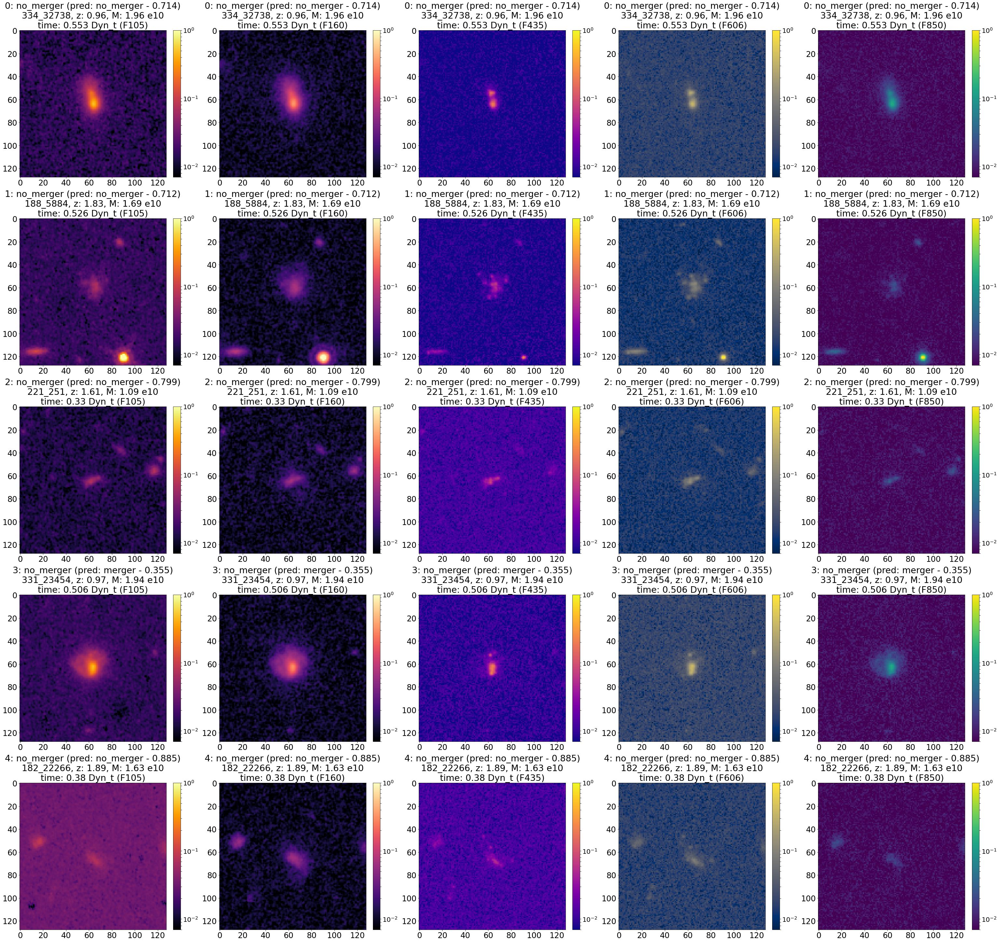

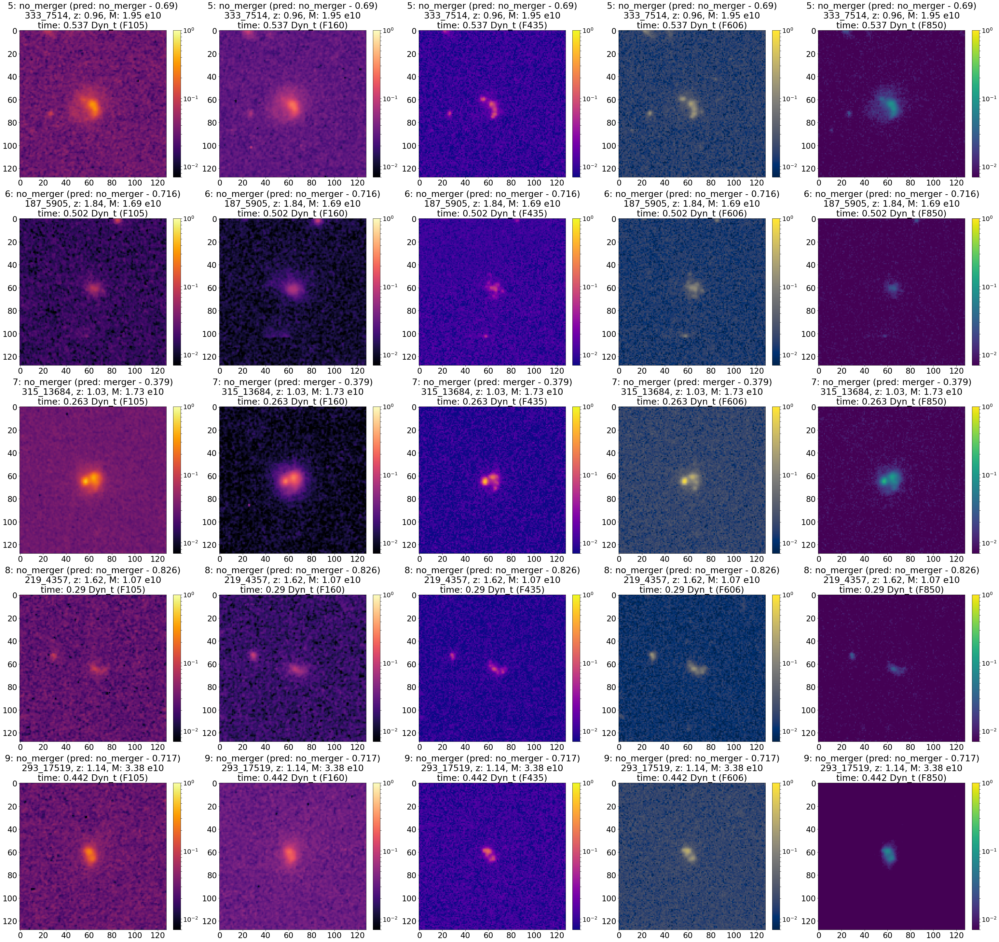

In [97]:
# Prints how many Late-Post images were classified correctly in the training-set and tesiting-set:

# --- training-set ---
print('training set:\n-------------')

# Add new backgrounds to the training set, if required:
if addBackgroundOnlyDuringLearning:
    training_img_set_withBG = np.copy(training_img_set)
    add_backgrounds_to_data_set(training_img_set_withBG)
else:
    training_img_set_withBG = training_img_set

# Get and process the predictions for the training set:
prediction_train = model.predict(training_img_set_withBG)  # 3*predictions matrix, with the percentages for each class for each prediction.
decisivePredictions_train, _, _ = get_decisive_predictions(prediction_train, None)  # A set of the final predictions.
decSubSet_train, subSet_train = [], []
# Collect the *true* late-post that are labeled as "no_mergers" in the training_label_set 
# and their predictions/classification from decisivePredictions_train:
for i, lbl in enumerate(training_label_set):
    if class_keys_reversed[np.argmax(lbl)] == no_merger and 'time' in training_info_set[i]:
        subSet_train.append(i)  # The index of a true labeled "no_mergers" which is a late-post.
        decSubSet_train.append(decisivePredictions_train[i])  # The classification of this image.

# Count and print the number of late-post no_mergers that were correctly classified as such:
lpCorrectClassifiedNum_train = sum([1 for decLblVal in decSubSet_train if decLblVal == class_keys[no_merger]])
print('Number of late-posts = ' + str(len(subSet_train)))
print('Number of late-posts correctly classified as no-mergers: ' + str(lpCorrectClassifiedNum_train) + '/' + \
      str(len(decSubSet_train)) + ' (' + str(100 * lpCorrectClassifiedNum_train / len(decSubSet_train)) + '%)')
print()


# --- test-set ---
print('test set:\n---------')

subSet, infSubSet, imgSubSet, lblSubSet, decSubSet, totsubSet = [], [], [], [], [], []
subSet = []
# Collect the *true* late-post that are labeled as "no_mergers" in the test_label_set 
# and their predictions/classification from decisivePredictions (plus some data):
for i, lbl in enumerate(test_label_set):
    if class_keys_reversed[np.argmax(lbl)] == no_merger and 'time' in test_info_set[i]:
        subSet.append(i)
        infSubSet.append(test_info_set[i])
        imgSubSet.append(test_img_set[i])
        lblSubSet.append(test_label_set[i])
        decSubSet.append(decisivePredictions[i])
        totsubSet.append(totalCorrelation[i])

# Count and print the number of late-post no_mergers that were correctly classified as such:
lpCorrectClassifiedNum_test = sum([1 for decLblVal in decSubSet if decLblVal == class_keys[no_merger]])
print('Number of late-posts = ' + str(len(subSet)))
print('Number of late-posts correctly classified as no-mergers: ' + str(lpCorrectClassifiedNum_test) + '/' + \
      str(len(decSubSet)) + ' (' + str(100 * lpCorrectClassifiedNum_test / len(decSubSet)) + '%)')

# Plot some of those images from the testing set, both correctly and wrongly classified ones:
infSubSet = np.array(infSubSet)
imgSubSet = np.array(imgSubSet)
lblSubSet = np.array(lblSubSet)

# Plots Late-Post images:
iStart, iEnd = 0, 10 # len(subSet)
testExtraInfoToPrint = [(str(extraInfo['ID'] + ', ') if 'ID' in extraInfo else '') + \
                        ('z: ' + str(np.round(extraInfo['z'], 2)) + ', ') + \
                        ('M: ' + str(np.round(extraInfo['mass'], 2)) + ' e10' + '\n') + \
                        ('time: ' + str(extraInfo['time']) if \
                        'time' in extraInfo else '') for extraInfo in infSubSet[iStart:iEnd]]
imgSubSet_withBG = np.copy(imgSubSet[iStart : iEnd])
add_backgrounds_to_data_set(imgSubSet_withBG)  # Adding new backgrounds.
plot_img_in_blocks(imgSubSet_withBG, lblSubSet[iStart:iEnd], \
                   testExtraInfoToPrint, decSubSet[iStart:iEnd], \
                   totsubSet[iStart:iEnd])


Plots Mergers


/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:923: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:924: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:898: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


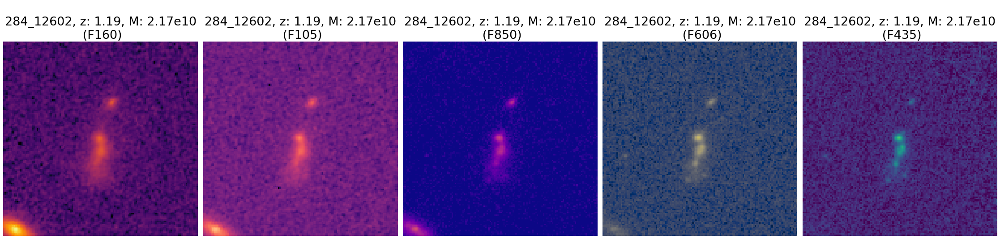

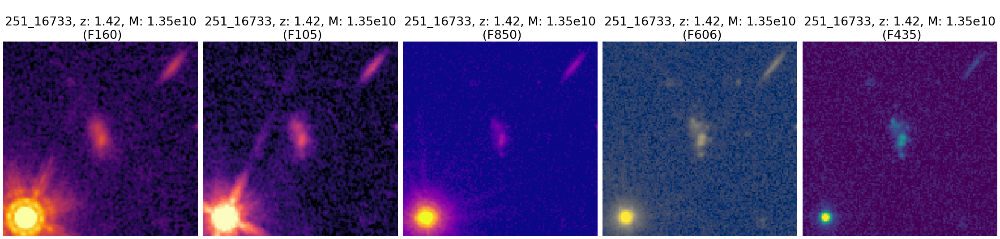

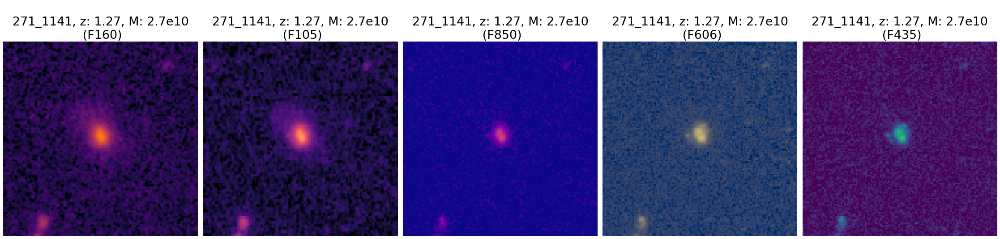

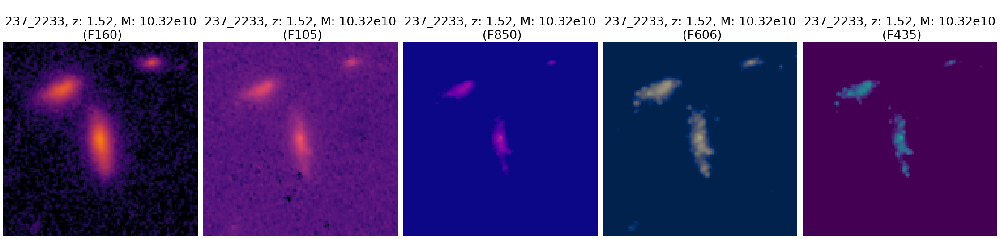

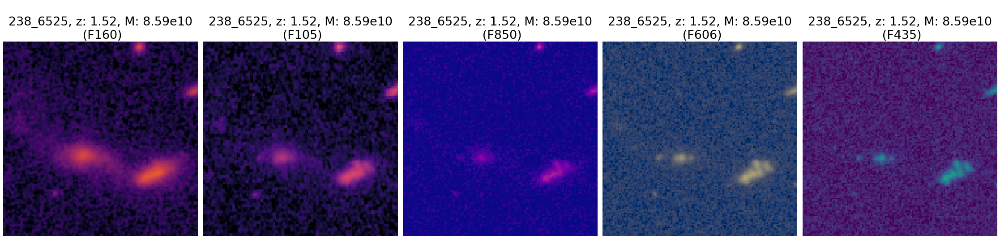

...

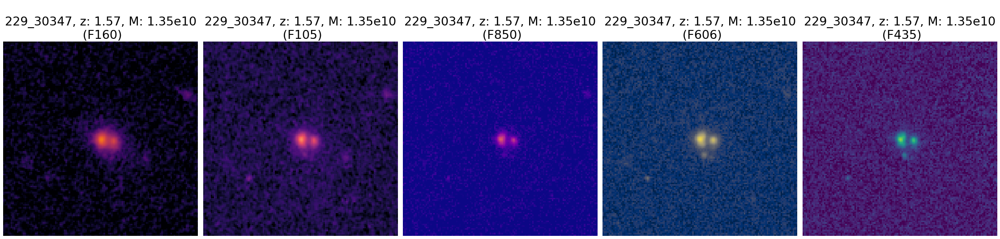

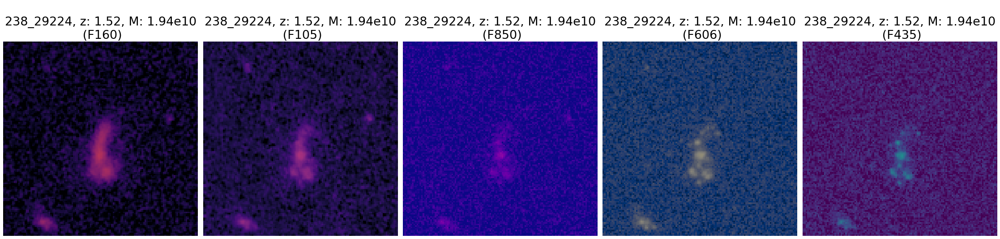

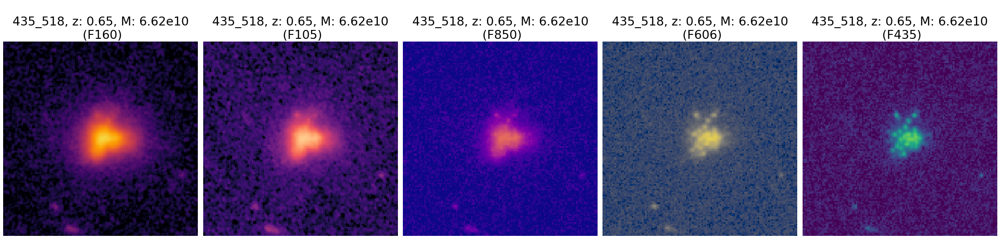

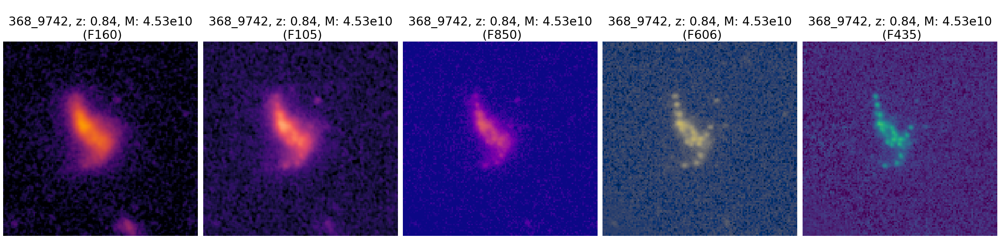

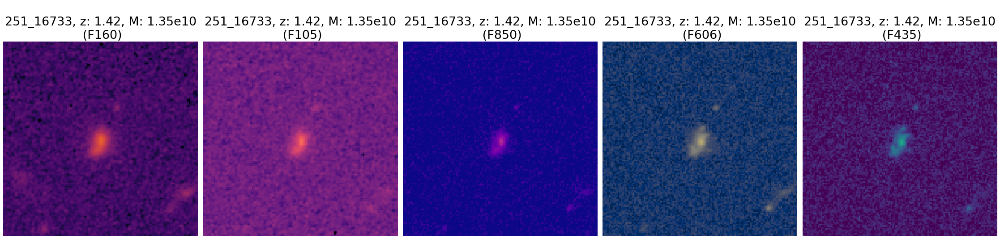

In [200]:
# Plots Mergers only:
print('Plots Mergers')
plot_classImgs(test_img_set, decisivePredictions, 'merger', 0, 50, plotLabels=False, \
               plotExtrInfo=True, plotDecPred=False, plotCorelations=False, \
               info_set=test_info_set)

Plots No-Mergers


/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:923: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:924: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
/vol/sci/astro/home/alon_haviv/miniconda3/envs/tf2/lib/python3.6/site-packages/ipykernel_launcher.py:898: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


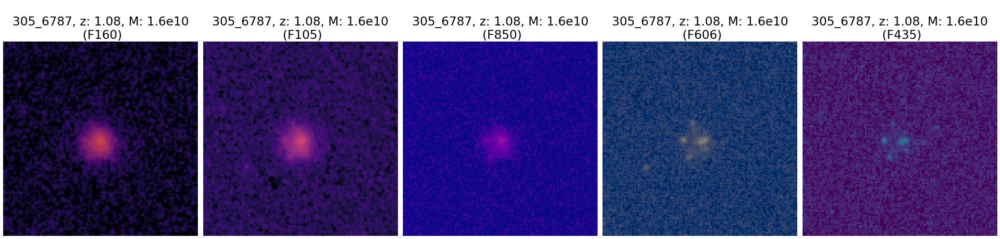

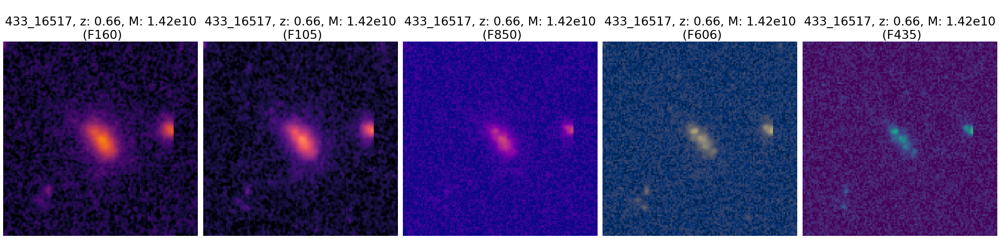

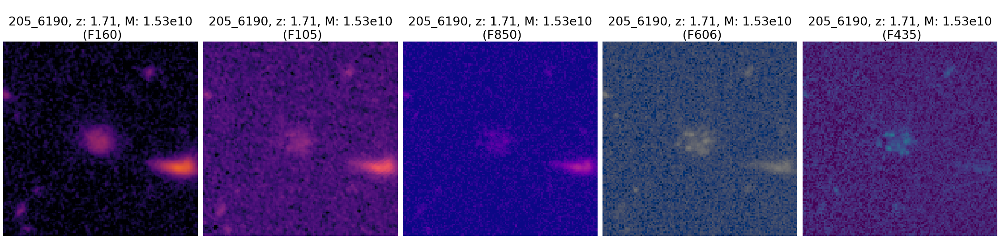

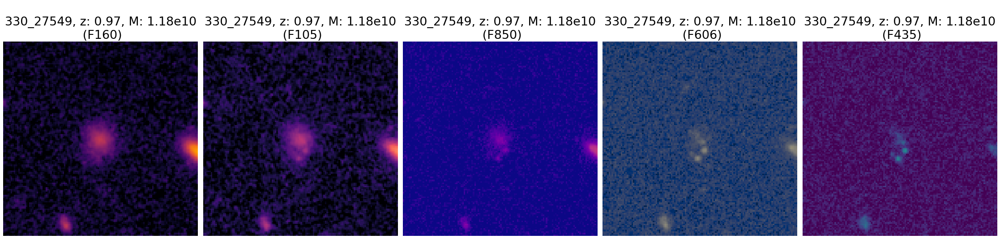

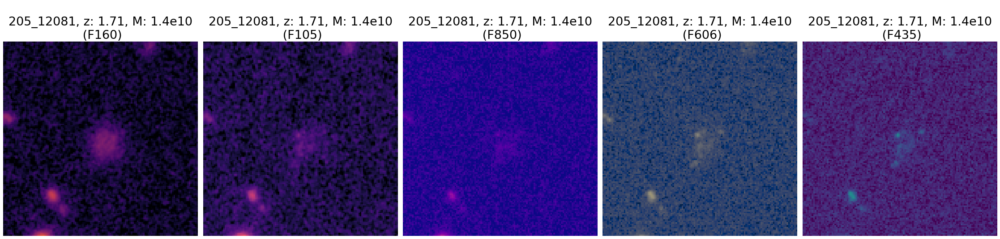

...

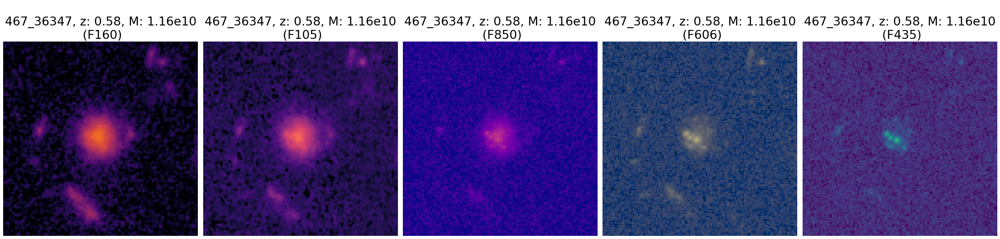

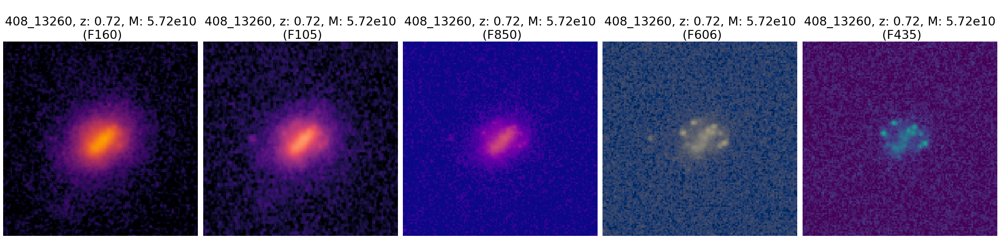

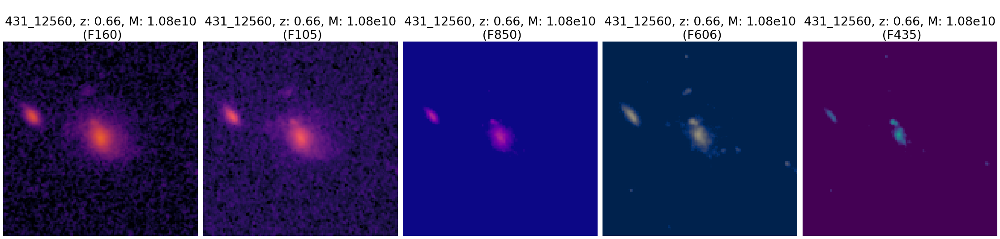

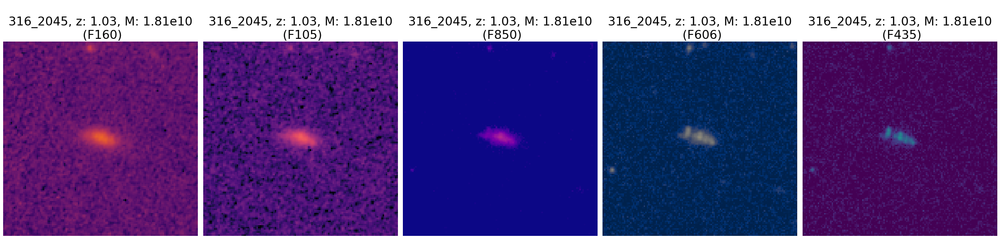

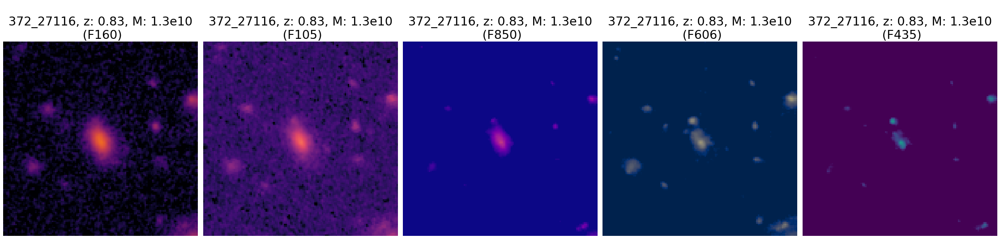

In [201]:
# Plots No-Mergers only:
print('Plots No-Mergers')
plot_classImgs(test_img_set, decisivePredictions, no_merger, 0, 50, plotLabels=False, \
               plotExtrInfo=True, plotDecPred=False, plotCorelations=False, \
               info_set=test_info_set)

In [ ]:
# To free-up space:
if chooseBackground != 0 and addBackgroundOnlyDuringLearning:
    close_background_tensor(backgroundTensor)
    del backgroundTensor

In [84]:
# If allowed, saves the trained model for later use:
if saveTrainedModel:
    if addBackgroundOnlyDuringLearning and backgroundPathAddition != '':
        modelBGPathAddition = 'trained_model' + backgroundPathAddition
    else:
        modelBGPathAddition = ''
    
    if loadPreTrainedModel:
        modelBGPathAddition += '_pre-trained'
    
    modelPathToSave = os.path.join(get_data_structure_specific_case_dir(), modelBGPathAddition, 'trained_model')
    print('Saving the model in: \"' + modelPathToSave + '\":\n')
    model.save(modelPathToSave)

Saving the model in: "/vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/case13merger(pre(-01-0)-post(0-01))_VS_no-mergers(w025-)_filters-F105F160F435F606F850_padded_and_cropped_128_centered_0_bg_z--Balanced_dynT_psf_z(0-2)/trained_model_CANDELSbg/trained_model":

INFO:tensorflow:Assets written to: /vol/sci/astro/cosmo/nas3/alon/DLproject/data_structures/major_mergers_VS_no_mergers/case13merger(pre(-01-0)-post(0-01))_VS_no-mergers(w025-)_filters-F105F160F435F606F850_padded_and_cropped_128_centered_0_bg_z--Balanced_dynT_psf_z(0-2)/trained_model_CANDELSbg/trained_model/assets
